In [1]:
import os
import copy
import os.path 
import cv2
import tkinter as tk
import tkinter.filedialog as fd
from PIL import Image, ImageEnhance
from skimage import transform, img_as_int, exposure, img_as_ubyte
import skimage.io as io
import skimage as si
import tkinter.messagebox as mb
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import blob_log, blob_doh, blob_dog
from scipy import ndimage, spatial
from cmath import inf
import sys
import numpy as np
from scipy.optimize import curve_fit
import json
from Bio import SeqIO
from skimage.filters import gaussian
import pandas as pd
from skimage.feature import peak_local_max
from sklearn.metrics import mean_squared_error
from numpy.linalg import norm
from math import floor, ceil, exp
from skimage.registration import phase_cross_correlation
from scipy import ndimage as ndi
from scipy.io import savemat
import Polywarp
import itertools
import scipy.spatial
import star
from skimage.restoration import rolling_ball


root = tk.Tk()
root.attributes("-topmost", True)
root.withdraw()

''

## Was the data collected in the ALEX regime?
 

In [2]:
# ALEX = False
ALEX = True
if ALEX:
    green_frames = np.add(1,np.multiply(2,range(10)))
    red_frames = np.subtract(green_frames,1)

## Choose the tile

In [26]:
current_tile = 1102

## Provide the matching coordinates for the tile

In [27]:
# DO NOT ERASE PREVIOUS COORDINATES. ADD NEW LINES AND LABEL THE EXPERIMENT


#240124_Ha_4N_ALEX_Tile_1
# coords_t_seq = np.array([-3009.476,234]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0,0])
#240124_Ha_4N_ALEX_Tile_2
# coords_t_seq = np.array([106.645,233.696]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0,0])

#230215_Tile_3
# coords_t_seq = np.array([2472.485,1187.175]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([9029.710,1510.853])


#2023-01-26 Tile 1
#coords_t_seq = np.array([1537.5,1398]) #Insert matching bead coordinates here manually!
#coords_t_FRET = np.array([6335,1470.5])
#2023-01-26 Tile 2
# coords_t_seq = np.array([1447.4,1449.7]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3118.5,1499.8])

#2023-01-23 Tile 1
# coords_t_seq = np.array([1505.5,1481.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([6893.9,1298.6])
#2023-01-23 Tile 2
# coords_t_seq = np.array([829,1559.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3111.6,1353.6])

#2022-12-27 Tile 1
# coords_t_seq = np.array([1451.532,1204.410]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3739.046,1271.476])
#2022-12-27 Tile 2
# coords_t_seq = np.array([2577.568,1054.075]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([1751.353,1126.065])

#2023-01-16 Tile 1
# coords_t_seq = np.array([2067,348]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([8813, 785]) 
#2023-01-16 Tile 2
# coords_t_seq = np.array([986,888]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([4644, 1300]) 

#2023-01-17 Tile 1
# coords_t_seq = np.array([1525.5,1810.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([7238, 970.6]) 
#2023-01-17 Tile 2
# coords_t_seq = np.array([1333.4,1987.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3971.3, 1154.7]) 


In [28]:
# Initial match smFRET vs Seq
# deltax = 4660 # for tile 1 220815
# deltay = -25
# upper_left_um_x = 26091.3
# upper_left_um_y = -690
# Select library sequences from the FASTQ data
def library_index(template, strings, min_matches):
    row_sums = [sum(a == b for a, b in zip(row, template)) for row in strings]
    # Create the index of elements from Seq where row_sums is above the threshold
    index = [i for i, row_sum in enumerate(row_sums) if row_sum > min_matches]
    return index

def get_pos(record):
    
    des = record.description
    tile_num = int(des.split(' ')[0].split(':')[4])
    x_pos = int(des.split(' ')[0].split(':')[5])
    y_pos = int(des.split(' ')[0].split(':')[6])
    return tile_num, x_pos, y_pos


def generate_img(x, y, x_min, y_min, x_max, y_max, r, blurred, sigma):
    # x_min = min(x)
    # x_max = max(x)
    # y_min = min(y)
    # y_max = max(y)
    x_range = x_max - x_min
    y_range = y_max - y_min
    # x_range = 27994
    # y_range = 27174
    img = np.zeros(shape=(x_range, y_range))
    for i in range(0, len(x)):
        img[min(x_range-1,max(0,int(x[i]-r))):min(x_range-1,max(0,int(x[i]+r+1))),min(y_range-1,max(0,int(y[i]-r))):min(y_range-1,max(0,int(y[i]+r+1)))] = 200

    if blurred:
        img = gaussian(img, sigma=sigma)
    im = Image.fromarray(img)
    new_im = im.convert("L")
#     new_im.save(op_path)
    return new_im


def generate_with_marker(x, y, marker_x, marker_y, op_path, csv_path):
    x_min = min(x)
    x_max = max(x)
    y_min = min(y)
    y_max = max(y)
    x_range = x_max - x_min + 1
    y_range = y_max - y_min + 1
    img = np.zeros(shape=(x_range, y_range, 3))
    marker_dic = {'index': range(0, len(marker_x)), 'x': [], 'y': []}
    for i in range(0, len(x)):
        for j in range(0, 5):
            for k in range(0, 5):
                img[max(0, x[i] - x_min - j),
                    max(0, y[i] - y_min - k), 0:3] = 255
                img[min(x_range - 1, x[i] - x_min + j),
                    max(0, y[i] - y_min - k), 0:3] = 255
                img[min(x_range - 1, x[i] - x_min + j),
                    min(y_range - 1, y[i] - y_min + k), 0:3] = 255
                img[max(0, x[i] - x_min - j),
                    min(y_range - 1, y[i] - y_min + k), 0:3] = 255
    for i in range(0, len(marker_x)):
        marker_dic['x'].append(marker_x[i] - x_min)
        marker_dic['y'].append(marker_y[i] - y_min)
        for j in range(0, 5):
            for k in range(0, 5):
                img[max(0, marker_x[i] - x_min - j),
                    max(0, marker_y[i] - y_min - k), 0] = 255
                img[max(0, marker_x[i] - x_min - j),
                    max(0, marker_y[i] - y_min - k), 1:3] = 0
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    max(0, marker_y[i] - y_min - k), 0] = 255
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    max(0, marker_y[i] - y_min - k), 1:3] = 0
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    min(y_range - 1, marker_y[i] - y_min + k), 0] = 255
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    min(y_range - 1, marker_y[i] - y_min + k), 1:3] = 0
                img[max(0, marker_x[i] - x_min - j),
                    min(y_range - 1, marker_y[i] - y_min + k), 0] = 255
                img[max(0, marker_x[i] - x_min - j),
                    min(y_range - 1, marker_y[i] - y_min + k), 1:3] = 0
    blurred_img = gaussian(img, sigma=3, multichannel=True)
    im = Image.fromarray(blurred_img.astype(np.uint8))
    new_im = im.convert("P")
    new_im.save(op_path)
    df = pd.DataFrame(marker_dic)
    df.to_csv(csv_path, index=True, header=True)


def get_coordinates(fastq_path):
    x_coordinate_01 = []
    y_coordinate_01 = []
    x_coordinate_02 = []
    y_coordinate_02 = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == 1101:
                x_coordinate_01.append(x_pos)
                y_coordinate_01.append(y_pos)
            elif tile_num == 1102:
                x_coordinate_02.append(x_pos)
                y_coordinate_02.append(y_pos)
#     print('Coordinates are found.')
    return x_coordinate_01, y_coordinate_01, x_coordinate_02, y_coordinate_02


def get_xy_coordinates(fastq_path, with_seq):
    x_coordinate_01 = []
    y_coordinate_01 = []
    x_coordinate_02 = []
    y_coordinate_02 = []
    x_seq_coordinate_01 = []
    y_seq_coordinate_01 = []
    x_seq_coordinate_02 = []
    y_seq_coordinate_02 = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == 1101:
                if with_seq != seq:
                    x_coordinate_01.append(x_pos)
                    y_coordinate_01.append(y_pos)
                else:
                    x_seq_coordinate_01.append(x_pos)
                    y_seq_coordinate_01.append(y_pos)
            elif tile_num == 1102:
                if with_seq != seq:
                    x_coordinate_02.append(x_pos)
                    y_coordinate_02.append(y_pos)
                else:
                    x_seq_coordinate_02.append(x_pos)
                    y_seq_coordinate_02.append(y_pos)
#     print('Coordinates are found.')
    return x_coordinate_01, y_coordinate_01, \
        x_coordinate_02, y_coordinate_02, \
        x_seq_coordinate_01, y_seq_coordinate_01, \
        x_seq_coordinate_02, y_seq_coordinate_02


def get_seq_coordinates(fastq_path, tile):
    x_coordinate = []
    y_coordinate = []
    sequences = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == tile:
                x_coordinate.append(x_pos/10)
                y_coordinate.append(y_pos/10)
                sequences.append(seq)
#     print('Coordinates are found.')
    return x_coordinate, y_coordinate, sequences

def scaling_seq (x, y):
    
    x = int(deltax+(335-x_border)/2 + (x - upper_left_um_x)/0.34) # tile 2 06/09/2022;
    y = int(deltay+(150-y_border)/2  - (y - upper_left_um_y)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     
#     x = int(-850+(305-x_border)/2 + (x - 26384)/0.34) # tile 2 06/09/2022;
#     y = int(-385+(154-y_border)/2  - (y + 407.1)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     x = int(-3967+(305-x_border)/2 + (x - 26384)/0.34) # tile 1 06/09/2022; 
#     y = int(-405+(154-y_border)/2  - (y + 407.1)/0.34)   

#     x = int(1700+(330-x_border)/2  + (x - 27246.18)/0.34 ) ### tile 2 19/07/2022
#     y = int(1571+(170-y_border)/2 - (y + 1149.66)/0.34)
#     x = int(2329+(330-x_border)/2 + (x - 28522.9)/0.34)  ### tile 1 19/07/2022
#     y = int(2042+(170-y_border)/2 - (y + 1313.3)/0.34)

    
    
    return (x,y)
    

def blob_detection(img, min_sigma, max_sigma, threshold, method=0):
    """This function is mostly used for detecting the beads in any image.

    Args:
        img_path (string): The absolute path of the input image.
        min_sigma (int): The minimum sigma, lower it is, smaller the blob will be detected.
        max_sigma (int): The maximum sigma, higher it is, bigger the blob will be detected.
        threshold (float): Higher it is, higher the intensities of blobs.
        method (int, optional): 0 for Difference of Gaussian (DoG) and 1 for Determinant of Hessian (DoH). 
        They should be applied with different combination of parameters. DoG is more suitable for fret movies,
        while DoH is more suitable for sequencing images. Defaults to 0.

    Returns:
        centers: A numpy array containing the coordinates of all the centers.
    """
    #img = io.imread(img_path)
    fig, ax = plt.subplots()
    ax.imshow(img)
    if method == 0:
        blob = blob_dog(
            img, min_sigma=min_sigma, max_sigma=max_sigma, threshold=threshold
        )
    else:
        blob = blob_doh(
            img, min_sigma=min_sigma, max_sigma=max_sigma, threshold=threshold
        )
    i = 0
    r = 3
    centers = []
    h, w = img.shape
    for blob in blob:
        y, x, r = blob
        if y > r and y < (h - r) and x > r and x < (w - r):
            centers.append(
                ndimage.measurements.center_of_mass(
                    img[int(y - r) : int(y + r + 1), int(x - r) : int(x + r + 1)]
                )
            )
            centers[i] = list(np.add(np.flip(centers[i]), [x - r, y - r]))
            x1, y1 = centers[i]
            c = plt.Circle([x1, y1], 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
            
            i += 1
    ax.set_axis_off()
    plt.show()
    return np.array(centers)

def count_nearest_pts(src, dst, radius):
    """Counting the number of nearest neighbors for each given point.

    Args:
        src (numpy array): (N, 2) shape array. Build the kd tree based on this.
        dst (numpy array): (N, 2) shape array. For each point in this array, find the nearest neighbors in src array.
        radius (int): The maximum searching radius.

    Returns:
        res, idx: res is the distance for the point and its neighbor, 'inf' means no neighbor in given search radius. 
        idx is the index for the neighbor in src array.
    """
    tree = spatial.KDTree(src)
    res, idx = tree.query(dst, k=1, distance_upper_bound=radius)
    for i in range(0, len(idx)):
        idx_t = np.argwhere(idx == idx[i])
        if len(idx_t) > 1:
            res_t = [res[j] for j in idx_t]
            if res[i] > min(res_t): res[i] = inf
    return res, idx

class App(tk.Tk):
    
    def __init__(self):
        super().__init__()
        btn_file = tk.Button(self, text="Choose file",
                             command=self.choose_file)
        btn_dir = tk.Button(self, text="Choose folder",
                             command=self.choose_directory)
        btn_file.pack(padx=60, pady=10)
        btn_dir.pack(padx=60, pady=10)
        

    def choose_file(self):
        filetypes = (("All formats ", "*"),
                     ("Text file", "*.txt"),
                     ("Image", "*.jpg *.gif *.png *.bmp *.tif"))
        filename = fd.askopenfilename(title="Open file", initialdir="/",
                                      filetypes=filetypes)
        if filename:
            self.st = filename
            #print (filename)
           
            
    def choose_directory(self):
        directory = fd.askdirectory(title="Open folder", initialdir="/")
        if directory:
            self.dir = directory
#             print (directory)


In [3]:
import numpy as np
print(np.load("F:/MUSCLE_Science_2024_data/Datasets/MUSCLE_Cas9_4N_repeat1/tform_result.npy"))

[[-9.61697903e+00  1.00759118e+00 -2.09578262e-02 -9.19957960e-06
   2.05288455e-04  2.32302136e-04  1.28485693e-09 -7.39147816e-07
  -1.76266209e-06 -5.57814569e-07  0.00000000e+00  9.83669011e-10
   6.77241722e-09  3.77321125e-09  0.00000000e+00  0.00000000e+00
   0.00000000e+00 -9.44626564e-12 -1.46418287e-11  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   2.13587091e-14  0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.92008721e+00 -1.00801915e-02  1.00154382e+00  2.75825640e-06
   7.15893486e-05 -2.67583312e-05  4.39460356e-09 -3.86987434e-07
  -1.05209458e-06  9.23405010e-08  0.00000000e+00  3.26423970e-10
   6.31447787e-09  3.43698816e-09  0.00000000e+00  0.00000000e+00
   0.00000000e+00 -7.15178179e-12 -2.14477210e-11  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   2.61619068e-14  0.00000000e+00  0.00000000e+00  0.00000000e+00]]


In [29]:
#Instead of calculating the bead mapping we can load the transformation generated with channel_map


tr_G2R = transform.PolynomialTransform()
file_path = fd.askopenfilename(title = "Choose the forward transform file", initialdir = "C:/Users/Anton/Documents/Jupyter home/ExampleData/Test_folder/220717_FC_Nano_200nm_Multicolor/original")
tr_G2R.params = np.load(file_path)
tr_R2G = transform.PolynomialTransform()
file_path = fd.askopenfilename(title = "Choose the inverse transform file", initialdir = os.path.dirname(file_path))
tr_R2G.params = np.load(file_path)

# x_border = int(input("Enter the x border"))
# y_border = int(input("Enter the y border"))
x_border = 500
y_border = 300

apriori_tr_original = transform.SimilarityTransform()
apriori_tr_original.params = np.array([[ 5.98278480e-01, -2.04811207e-03,  0],
 [ 2.04811207e-03,  5.98278480e-01,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

apriori_tr = transform.SimilarityTransform()
apriori_tr.params = np.array([[ 5.98278480e-01, -2.04811207e-03,  0],
 [ 2.04811207e-03,  5.98278480e-01,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# Centering the tranformation to the x_border and y_border
delta = 0.5*np.subtract([x_border,y_border],apriori_tr([512,256]))
dx, dy = delta[0]
apriori_tr.params[0,2] = dx
apriori_tr.params[1,2] = dy

apriori_tr_inv = transform.SimilarityTransform()
apriori_tr_inv.params = np.array([[ 1.67127284e+00,  5.72133913e-03,  0],
 [-5.72133913e-03,  1.67127284e+00,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# Centering the tranformation to the x_border and y_border
delta = 0.5*np.subtract([512,256],apriori_tr_inv([x_border,y_border]))
dx, dy = delta[0]
apriori_tr_inv.params[0,2] = dx
apriori_tr_inv.params[1,2] = dy

# fastq_path = 'E:/MUSCLE data/0722.fastq'
fastq_path = fd.askopenfilename(title = "Choose the FASTQ file", initialdir = "D:/Experiments/MUSCLE DONUTS/")
base_path = os.path.dirname(fastq_path)

x_coord, y_coord, sequence = get_seq_coordinates(fastq_path,  tile=current_tile)

# print(len(x_coordinate_01))
# print(len(x_coordinate_02))
# print(np.max(x_coordinate_01))
# print(np.min(x_coordinate_01))

# max_y  = max (y_coord)
# max_x = max (x_coord)
max_y  = max_x = 3000 # To ensure that the alignment is not affected by changes in max x and y


x_coord1 = np.subtract(max_y, y_coord)
y_coord = np.subtract(max_x, x_coord)

x_coord = x_coord1
# Selecting the library sequences for further analysis
# Cas9_Ha library:
# library_seq =  'GGTCTCGCACAGCAGAAATCTCTACTGAGGTATAAAGATGAGACGCTGGAGTAAAAACGTTGGTTGGCT'
library_seq =  'GGTCTCGTCCATGGCGACGGCAGCGAGGCGAATGGCGGTTAAAAAAAAAAAAAAAAATGCCCTCCACGAT'

idx = library_index(library_seq, sequence, 40)

# Control CCR5 library
library_seq_ctrl = 'GGTCTCGTCCAATCTACCAAATCACTTATTATCCATCGGAGCCCTGCCAATATCGTATGCCGTCTTCTGC'
idx = idx + library_index(library_seq_ctrl, sequence, 40)


x_coord = [x_coord[i] for i in idx]
y_coord = [y_coord[i] for i in idx]
sequence = [sequence[i] for i in idx] 


fastq_image = generate_img(y_coord,x_coord, 0, 0, max_x, max_y, 1, True, 1)
current_direct = fd.askdirectory(title = "Choose the output folder", initialdir = base_path)

fastq_image.save(os.path.join(current_direct, 'FASTQ_image.png'))

file_path = fd.askopenfilename(title = "Choose the position list", initialdir = base_path)


pos_file = open(file_path)
data = json.load(pos_file)
POS = data['POSITIONS']

labels = [P['LABEL'] for P in POS]
posX = [P['DEVICES'][1]['X'] for P in POS]
posY = [P['DEVICES'][1]['Y'] for P in POS]
upper_left_um_x = min(posX)
upper_left_um_y = max(posY)

size1 = apriori_tr_original([[256,512]]).astype(int)
print(size1)

minx = min(posX)
maxx = max(posX)
miny = min(posY)
maxy = max(posY)

size = [maxy-miny+50+size1[0,0], maxx-minx+50+size1[0,1]]
size = np.divide(size,0.34).astype(int)
print(size)

img = np.zeros(size)

path_smFRET = fd.askdirectory(title = "Choose the smFRET folder", initialdir = base_path)

[[152 306]]
[4300 7841]


In [10]:
### Creating a composite from smFRET images - skip if rough alignment if already done
show_im = False
for pos in labels:
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')
    else:
        continue

    
    print(pos)
    img_smFRET = io.imread(path1)

    # Averaging the first 10 frames to select peaks
    if ALEX:
#         img_t = np.mean(img_smFRET[green_frames,::], axis = 0)
        img_t = np.mean(img_smFRET[red_frames,::], axis = 0)
    else:
        img_t = np.mean(img_smFRET[0:10,::], axis = 0)
    img_t = img_t.astype("ushort")
    rb_rad = 10

    red = img_t[256:,:]
    green = img_t[:256,:]
    red = red - rolling_ball(red, radius=rb_rad)
    green = green - rolling_ball(green, radius=rb_rad)
    green = transform.warp(green,tr_R2G, preserve_range = True)
    combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
    if show_im:
        fig, ax = plt.subplots()
        ax.imshow(combined)
    blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=30) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
    CM = []
    r = 3
    [h,w] = red.shape
    
    for i, blob in enumerate(blobs_log):
        x, y, d = blob
        if x>r and x<(h-r) and y>r and y<(w-r):
            temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
            CM.append(np.flip(np.add(temp, [x-r,y-r])))
            if show_im:
                c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
                ax.add_patch(c)
    if show_im:
        ax.set_axis_off()
    #     plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
        plt.show()
    smFRET_centers = np.array(CM)
#     if img1.shape[0] == 512: # sometimes slice number is the first dimension, sometimes the third
#         img1 = np.mean(img1, axis = 2) #averaging by the stack
#     else:
#       img1 = np.mean(img1, axis = 0) #averaging by the stack
# #         img1 = np.mean(img1, axis = 0)
# #         img1 = np.mean(img1, axis = 2)
#     img1 = img1.astype("ushort")
#     img1 = img1[256:,:]
#     img1 = img1 - si.restoration.rolling_ball(img1, radius=rb_rad)
    smFRET_centers_tr = apriori_tr_original(smFRET_centers)
    smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0,size1[0,0], size1[0,1], 1, True, 1))
#     img1 = transform.warp(img1, tr_inv, output_shape = size1[0])
    x1 = [posX[i] for i,x in enumerate(labels) if labels[i]==pos]
    y1 = [posY[i] for i,x in enumerate(labels) if labels[i]==pos]
    id1 = int((maxy-y1[0])/0.34)
    id2 = int((x1[0]-minx)/0.34)

    img[id1:id1+size1[0,0],id2:id2+size1[0,1]] = smFRET_centers_tr_image_array
        
img2 = Image.fromarray(img.astype(np.byte))
img2 = img2.convert('L')
img2.save(current_direct+'/Combined.png')

print("DONE")


Pos00000


C:\Users\Anton\AppData\Local\Temp\ipykernel_4712\1602055639.py:46: DeprecationWarning: Please use `center_of_mass` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])


Pos00001
Pos00002
Pos00003
Pos00004
Pos00005
Pos00006
Pos00007
Pos00008
Pos00009
Pos00010
Pos00011
Pos00012
Pos00013
Pos00014
Pos00015
Pos00016
Pos00017
Pos00018
Pos00019
Pos00020
Pos00021
Pos00022
Pos00023
Pos00024
Pos00025
Pos00026
Pos00027
Pos00028
Pos00029
Pos00030
Pos00031
Pos00032
Pos00033
Pos00034
Pos00035
Pos00036
Pos00037
Pos00038
Pos00039
Pos00040
Pos00041
Pos00042
Pos00043
Pos00044
Pos00045
Pos00046
Pos00047
Pos00048
Pos00049
Pos00050
Pos00051
Pos00052
Pos00053
Pos00054
Pos00055
Pos00056
Pos00057
Pos00058
Pos00059
Pos00060
Pos00061
Pos00062
Pos00063
Pos00064
Pos00065
Pos00066
Pos00067
Pos00068
Pos00069
Pos00070
Pos00071
Pos00072
Pos00073
Pos00074
Pos00075
Pos00076
Pos00077
Pos00078
Pos00079
Pos00080
Pos00081
Pos00082
Pos00083
Pos00084
Pos00085
Pos00086
Pos00087
Pos00088
Pos00089
Pos00090
Pos00091
Pos00092
Pos00093
Pos00094
Pos00095
Pos00096
Pos00097
Pos00098
Pos00099
Pos00100
Pos00101
Pos00102
Pos00103
Pos00104
Pos00105
Pos00106
Pos00107
Pos00108
Pos00109
Pos00110
Pos00111
P

In [ ]:
# print(img.dtype)
# # from skimage.util import img_as_uint, img_as_ubyte        
# img2 = Image.fromarray(img.astype(np.byte))
# # print(img2)
# fig, ax = plt.subplots()
# ax.imshow(img2)
# plt.show()
# # print(img2.dtype)
# img2 = img2.convert('L')
# img2.save(current_direct+'/Combined.png')

# print("DONE")

In [30]:
# # Alternative version of figuring out the displacement
# file_path = fd.askopenfilename(title = "Choose the position list")

# pos_file = open(file_path)
# data = json.load(pos_file)
# POS = data['POSITIONS']

# labels = [P['LABEL'] for P in POS]
# posX = [P['DEVICES'][1]['X'] for P in POS]
# posY = [P['DEVICES'][1]['Y'] for P in POS]
# # print(min(posX), max(posX), min(posY), max(posY))
# upper_left_um_x = min(posX)
# upper_left_um_y = max(posY)

#2024-02-01 Tile 1
# coords_t_seq = np.array([-2877,-667]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-01 Tile 2
# coords_t_seq = np.array([241,-671]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-20 Tile 1
# coords_t_seq = np.array([-5073,-1071]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

# #2024-02-20 Tile 2
# coords_t_seq = np.array([-1952,-1069]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-22 Tile 1
# coords_t_seq = np.array([-3959,79]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-22 Tile 2
# coords_t_seq = np.array([-841,69]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-28 Tile 1
# coords_t_seq = np.array([-2761,-789]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

# #2024-03-05 Tile 1
# coords_t_seq = np.array([-2786,-526]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 
#2024-03-05 Tile 2
# coords_t_seq = np.array([333,-527]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-06 Tile 2
# coords_t_seq = np.array([288.5,-402]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-06 Tile 1
# coords_t_seq = np.array([-2830,-401]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-08 Tile 1
# coords_t_seq = np.array([-3391.5,-855]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-08 Tile 2
coords_t_seq = np.array([-272,-852]) #Insert matching bead coordinates here manually!
coords_t_FRET = np.array([0, 0]) 


#2024-02-28 Tile 2
# coords_t_seq = np.array([357,-793]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 


#2023-01-26 Tile 1
# coords_t_seq = np.array([1537.5,1398]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([6335,1470.5])

#2023-01-26 Tile 2
# coords_t_seq = np.array([1447.4,1449.7]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3118.5,1499.8])



#2023-01-23 Tile 1
# coords_t_seq = np.array([1505.5,1481.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([6893.9,1298.6])

#2023-01-23 Tile 2
# coords_t_seq = np.array([829,1559.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3111.6,1353.6])

#2022-12-27 Tile 1
# coords_t_seq = np.array([1451.532,1204.410]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3739.046,1271.476])

#2022-12-27 Tile 2
# coords_t_seq = np.array([2577.568,1054.075]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([1751.353,1126.065])

#2023-01-16 Tile 1
# coords_t_seq = np.array([2067,348]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([8813, 785]) 
#2023-01-16 Tile 2
# coords_t_seq = np.array([986,888]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([4644, 1300]) 

#2023-01-17 Tile 1
# coords_t_seq = np.array([1525.5,1810.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([7238, 970.6]) 
#2023-01-17 Tile 2
# coords_t_seq = np.array([1333.4,1987.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3971.3, 1154.7]) 


[deltax, deltay] = np.subtract(coords_t_seq,coords_t_FRET)
print(deltax,deltay)
print(upper_left_um_x, upper_left_um_y)


-272 -852
26408.100000000002 -533.8000000000002


In [31]:
# file_path = fd.askopenfilename(title = "Choose the position list", initialdir = base_path)


# pos_file = open(file_path)
# data = json.load(pos_file)
# POS = data['POSITIONS']

# labels = [P['LABEL'] for P in POS]
# posX = [P['DEVICES'][1]['X'] for P in POS]
# posY = [P['DEVICES'][1]['Y'] for P in POS]


#X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos287']
#Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos287']

labels_res = []
posX_res = []
posY_res = []
for i,x in enumerate(labels):
#     x = int(-850+(305-x_border)/2 + (posX[i] - 26384)/0.34) # tile 2 06/09/2022; 305 and 154 are the size of tfd 512 by 256 image
#     y = int(-385+(154-y_border)/2  - (posY[i] + 407.1)/0.34)  
#     x = int(-3967+(305-x_border)/2 + (posX[i] - 26384)/0.34) # tile 1 06/09/2022; 305 and 154 are the size of tfd 512 by 256 image
#     y = int(-405+(154-y_border)/2  - (posY[i] + 407.1)/0.34)   
#     x = int(1700+(330-x_border)/2 + (posX[i] - 27246.18)/0.34) # tile 2 19/07/2022
#     y = int(1571+(170-y_border)/2  - (posY[i] + 1149.66)/0.34)   
    x = int(deltax+(335-x_border)/2 + (posX[i] - upper_left_um_x)/0.34) # tile 2 06/09/2022;
    y = int(deltay+(150-y_border)/2  - (posY[i] - upper_left_um_y)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     x = int(2329+(330-x_border)/2 + (posX[i] - 28522.9)/0.34) # tile 1 19/07/2022
#     y = int(2042+(170-y_border)/2 - (posY[i] + 1313.3)/0.34) 
    if (x > 0 ) and (y > 0):
        if (y+y_border< 2944) and (x+x_border <2866) :
            labels_res.append (labels[i])
            posX_res.append (posX[i])
            posY_res.append( posY[i])


print (labels_res)

#print(usable_green_beads)
#print(usable_red_beads)



counter = 0  

# file_path = fd.askopenfilename(title = "Choose the MIN projection image", initialdir = base_path)
# seq = io.imread(file_path)#reading the sequence image
# seq = seq.astype("ushort") 

# file_path = fd.askopenfilename(title = "Choose the MAX projection image", initialdir = base_path)
# seq_max = io.imread(file_path)#reading the sequence image
# seq_max = seq_max.astype("ushort")
# image_array_max = np.asarray(seq_max)
good_pos = []
matched_sequences = []
matched_centers_red = []
matched_centers_green = []
matched_centers_FQ = []
matched_dist = []
processed_pos = []
FQ_shifts = []
FQ_shifts_pos = []

# image_array_seq = np.asarray(seq) #array from sequence image
# image_array_FQ = np.asarray(fastq_image) #array from fastq_image

# # path_smFRET = fd.askdirectory(title = "Choose the smFRET movie", initialdir = "D:/Experiments/MUSCLE DONUTS/20220824_FC_Nano_Cas9_CCR5/Cas9/green")
# plt.figure()
# plt.imshow(seq)
print('Number of overlapping FOVs: ',len(labels_res))

['Pos00024', 'Pos00025', 'Pos00026', 'Pos00027', 'Pos00028', 'Pos00029', 'Pos00030', 'Pos00057', 'Pos00058', 'Pos00059', 'Pos00060', 'Pos00061', 'Pos00062', 'Pos00063', 'Pos00068', 'Pos00069', 'Pos00070', 'Pos00071', 'Pos00072', 'Pos00073', 'Pos00074', 'Pos00101', 'Pos00102', 'Pos00103', 'Pos00104', 'Pos00105', 'Pos00106', 'Pos00107', 'Pos00112', 'Pos00113', 'Pos00114', 'Pos00115', 'Pos00116', 'Pos00117', 'Pos00118', 'Pos00145', 'Pos00146', 'Pos00147', 'Pos00148', 'Pos00149', 'Pos00150', 'Pos00151', 'Pos00156', 'Pos00157', 'Pos00158', 'Pos00159', 'Pos00160', 'Pos00161', 'Pos00162', 'Pos00189', 'Pos00190', 'Pos00191', 'Pos00192', 'Pos00193', 'Pos00194', 'Pos00195', 'Pos00200', 'Pos00201', 'Pos00202', 'Pos00203', 'Pos00204', 'Pos00205', 'Pos00206', 'Pos00233', 'Pos00234', 'Pos00235', 'Pos00236', 'Pos00237', 'Pos00238', 'Pos00239', 'Pos00244', 'Pos00245', 'Pos00246', 'Pos00247', 'Pos00248', 'Pos00249', 'Pos00250', 'Pos00277', 'Pos00278', 'Pos00279', 'Pos00280', 'Pos00281', 'Pos00282', 'Po

In [32]:
# Run this if you want to restart analysis from the beginning
processed_pos = []

# Main cycle. 
## Matching smFRET peaks and clusters

Working on: Pos00024

Working on: Pos00025



C:\Users\Anton\AppData\Local\Temp\ipykernel_4712\1621100723.py:195: DeprecationWarning: Please use `center_of_mass` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])


[-103.   87.]
Matched clusters before transform update:  476
Matched clusters after transform update:  650
Out of  2133  smFRET peaks and  1635  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  39


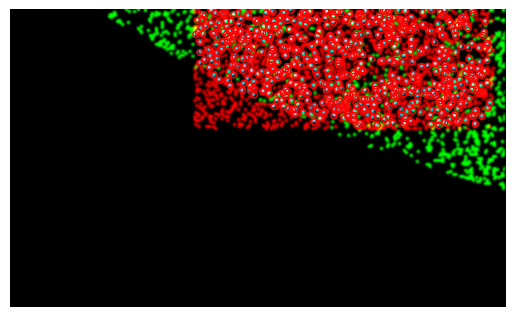

Working on: Pos00026

[  8. -19.]
Matched clusters before transform update:  642
Matched clusters after transform update:  706
Out of  2078  smFRET peaks and  3527  clusters
Percentage of matched smFRET peaks:  33
Percentage of matched clusters:  20


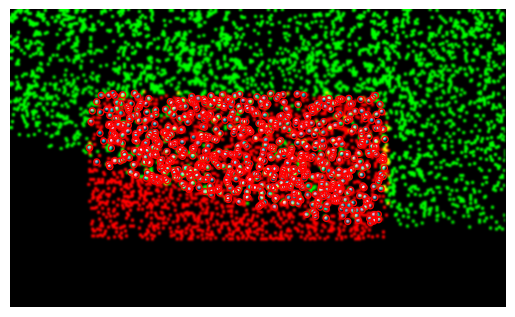

Working on: Pos00027

[  8. -18.]
Matched clusters before transform update:  774
Matched clusters after transform update:  856
Out of  2109  smFRET peaks and  3571  clusters
Percentage of matched smFRET peaks:  40
Percentage of matched clusters:  23


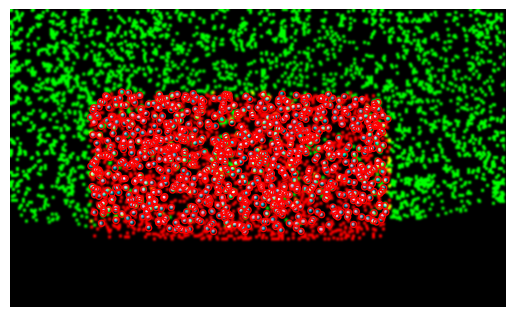

Working on: Pos00028

[  8. -16.]
Matched clusters before transform update:  581
Matched clusters after transform update:  633
Out of  2219  smFRET peaks and  2693  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  23


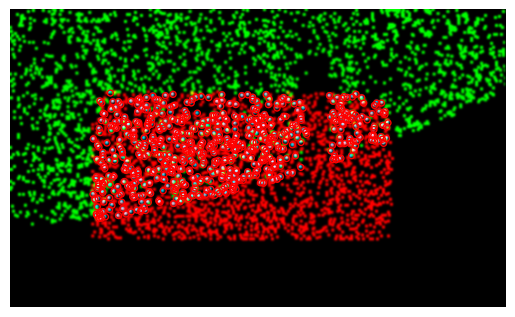

Working on: Pos00029

[-101. -120.]
Matched clusters before transform update:  347
Matched clusters after transform update:  479
Out of  2129  smFRET peaks and  901  clusters
Percentage of matched smFRET peaks:  22
Percentage of matched clusters:  53


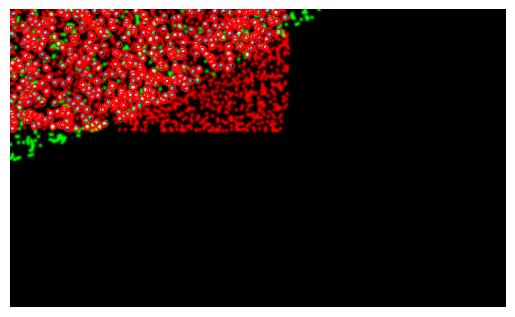

Working on: Pos00030

Working on: Pos00057

[ -87. -186.]
Matched clusters before transform update:  286
Matched clusters after transform update:  366
Out of  2167  smFRET peaks and  682  clusters
Percentage of matched smFRET peaks:  16
Percentage of matched clusters:  53


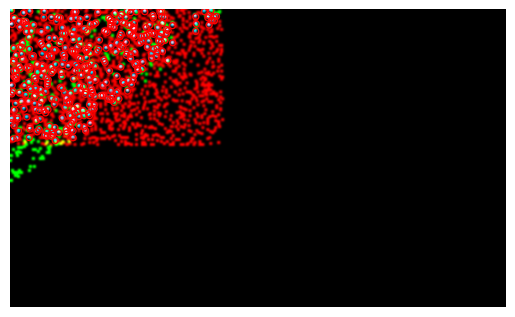

Working on: Pos00058

[  8. -11.]
Matched clusters before transform update:  718
Matched clusters after transform update:  774
Out of  2159  smFRET peaks and  3359  clusters
Percentage of matched smFRET peaks:  35
Percentage of matched clusters:  23


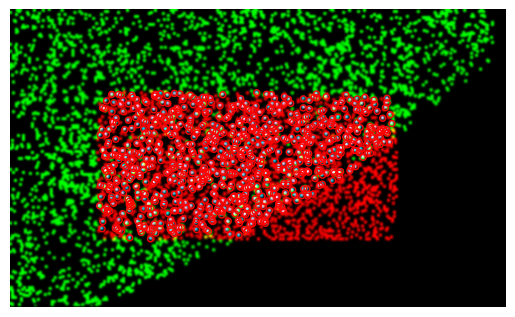

Working on: Pos00059

[  7. -12.]
Matched clusters before transform update:  960
Matched clusters after transform update:  996
Out of  2131  smFRET peaks and  4920  clusters
Percentage of matched smFRET peaks:  46
Percentage of matched clusters:  20


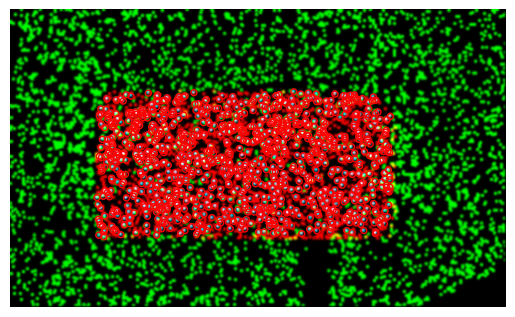

Working on: Pos00060

[  8. -14.]
Matched clusters before transform update:  884
Matched clusters after transform update:  922
Out of  2121  smFRET peaks and  5154  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  17


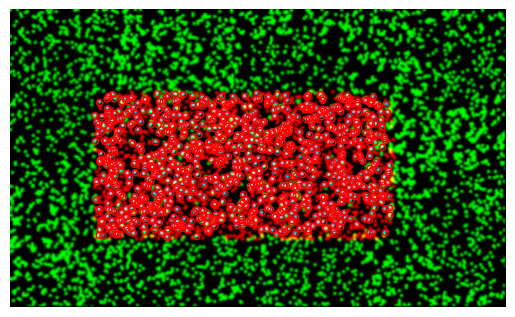

Working on: Pos00061

[  8. -15.]
Matched clusters before transform update:  839
Matched clusters after transform update:  873
Out of  2109  smFRET peaks and  5478  clusters
Percentage of matched smFRET peaks:  41
Percentage of matched clusters:  15


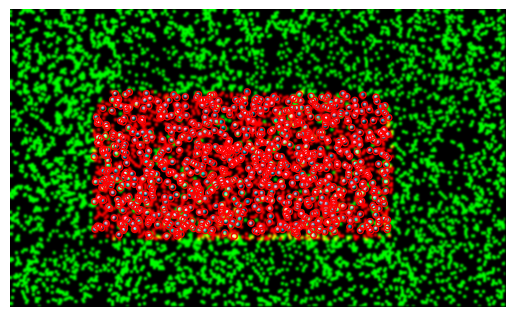

Working on: Pos00062

[  9. -18.]
Matched clusters before transform update:  888
Matched clusters after transform update:  956
Out of  2119  smFRET peaks and  4706  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  20


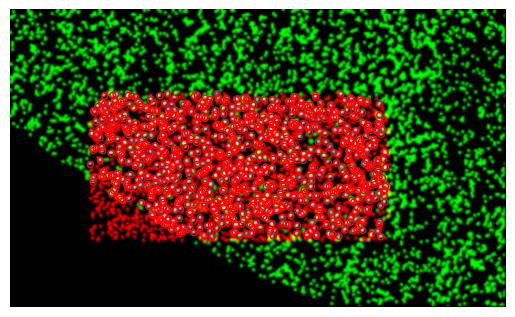

Working on: Pos00063

[-113.   99.]
Matched clusters before transform update:  449
Matched clusters after transform update:  576
Out of  2150  smFRET peaks and  1435  clusters
Percentage of matched smFRET peaks:  26
Percentage of matched clusters:  40


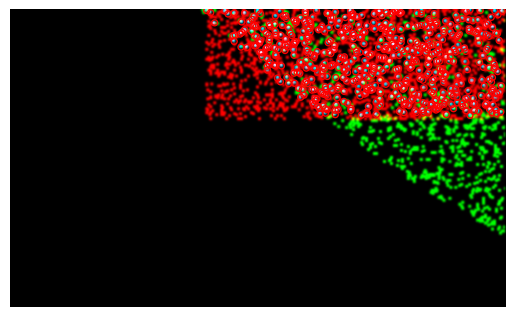

Working on: Pos00068

[  8. -23.]
Matched clusters before transform update:  611
Matched clusters after transform update:  636
Out of  2089  smFRET peaks and  3578  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  17


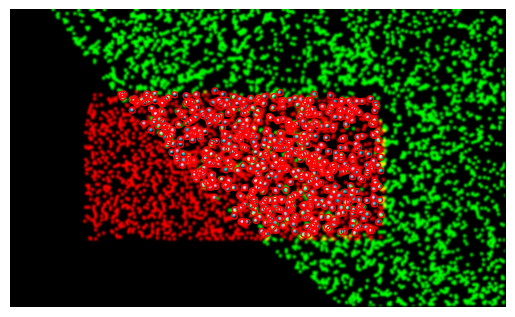

Working on: Pos00069

[  7. -21.]
Matched clusters before transform update:  914
Matched clusters after transform update:  965
Out of  2080  smFRET peaks and  5567  clusters
Percentage of matched smFRET peaks:  46
Percentage of matched clusters:  17


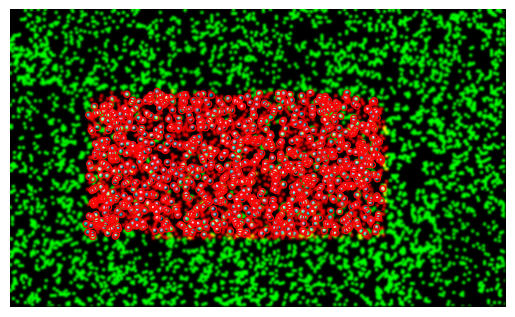

Working on: Pos00070

[  6. -18.]
Matched clusters before transform update:  886
Matched clusters after transform update:  925
Out of  2084  smFRET peaks and  5371  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


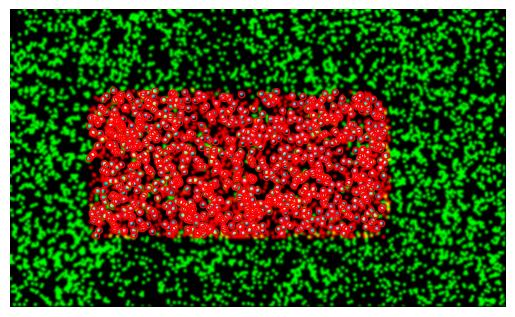

Working on: Pos00071

[  6. -17.]
Matched clusters before transform update:  925
Matched clusters after transform update:  983
Out of  2133  smFRET peaks and  5012  clusters
Percentage of matched smFRET peaks:  46
Percentage of matched clusters:  19


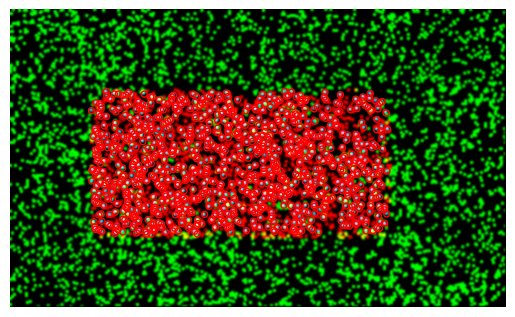

Working on: Pos00072

[  6. -15.]
Matched clusters before transform update:  823
Matched clusters after transform update:  862
Out of  2048  smFRET peaks and  4759  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  18


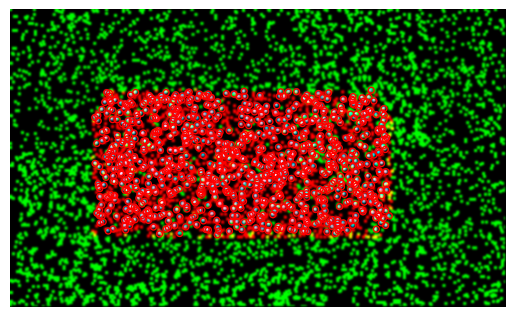

Working on: Pos00073

[  7. -14.]
Matched clusters before transform update:  850
Matched clusters after transform update:  908
Out of  2053  smFRET peaks and  4885  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


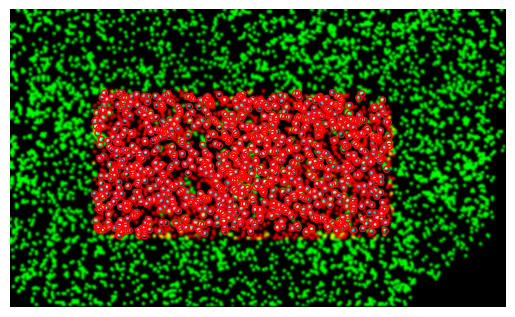

Working on: Pos00074

[-134.  225.]
Matched clusters before transform update:  16
Matched clusters after transform update:  24
Out of  2121  smFRET peaks and  2426  clusters
Percentage of matched smFRET peaks:  1
Percentage of matched clusters:  0


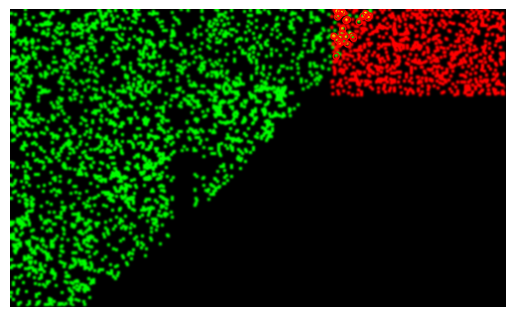

Working on: Pos00101

[ 5. -8.]
Matched clusters before transform update:  840
Matched clusters after transform update:  910
Out of  2146  smFRET peaks and  4139  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  21


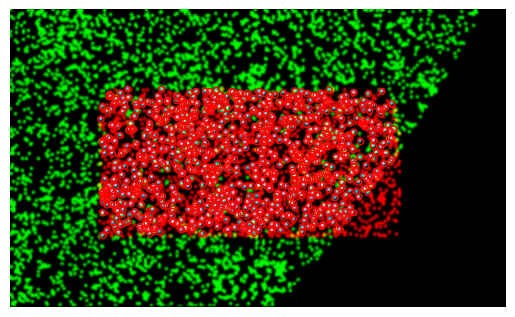

Working on: Pos00102

[  4. -11.]
Matched clusters before transform update:  840
Matched clusters after transform update:  856
Out of  2127  smFRET peaks and  4920  clusters
Percentage of matched smFRET peaks:  40
Percentage of matched clusters:  17


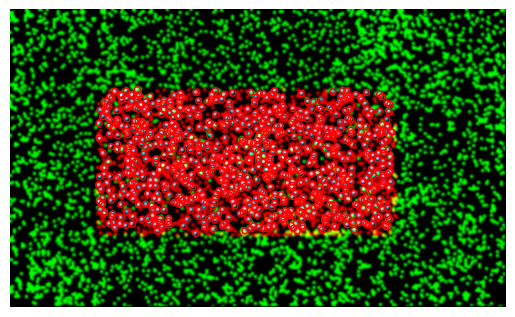

Working on: Pos00103

[  4. -12.]
Matched clusters before transform update:  818
Matched clusters after transform update:  852
Out of  2068  smFRET peaks and  4882  clusters
Percentage of matched smFRET peaks:  41
Percentage of matched clusters:  17


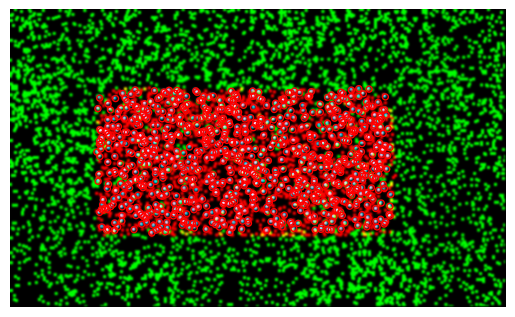

Working on: Pos00104

[  4. -13.]
Matched clusters before transform update:  876
Matched clusters after transform update:  909
Out of  2161  smFRET peaks and  4980  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  18


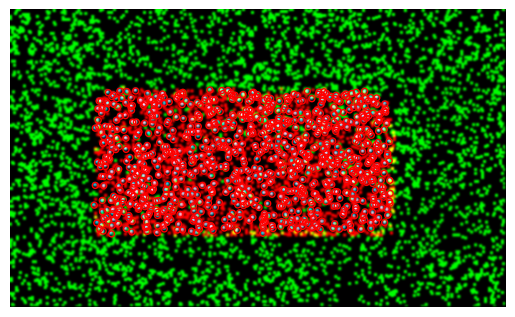

Working on: Pos00105

[  4. -14.]
Matched clusters before transform update:  876
Matched clusters after transform update:  910
Out of  2128  smFRET peaks and  4986  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  18


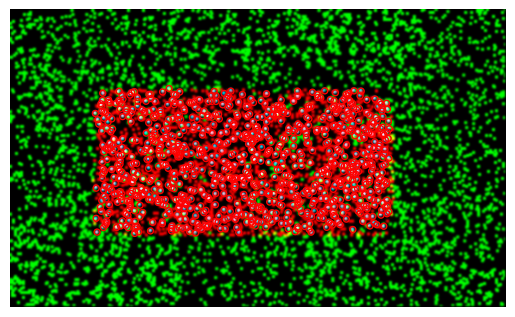

Working on: Pos00106

[  5. -17.]
Matched clusters before transform update:  834
Matched clusters after transform update:  885
Out of  2089  smFRET peaks and  5029  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  17


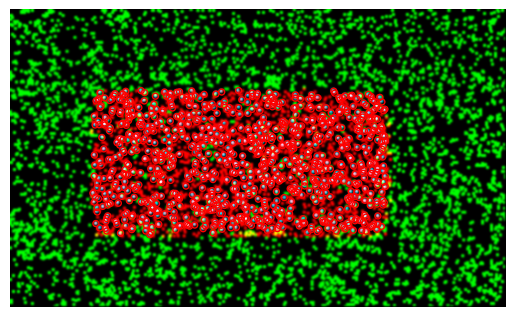

Working on: Pos00107

[  5. -19.]
Matched clusters before transform update:  927
Matched clusters after transform update:  1027
Out of  2151  smFRET peaks and  5017  clusters
Percentage of matched smFRET peaks:  47
Percentage of matched clusters:  20


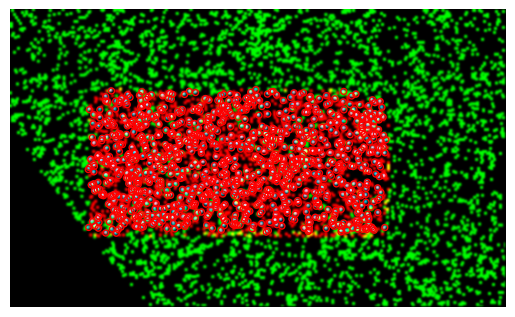

Working on: Pos00112

[  6. -23.]
Matched clusters before transform update:  919
Matched clusters after transform update:  1006
Out of  2166  smFRET peaks and  5345  clusters
Percentage of matched smFRET peaks:  46
Percentage of matched clusters:  18


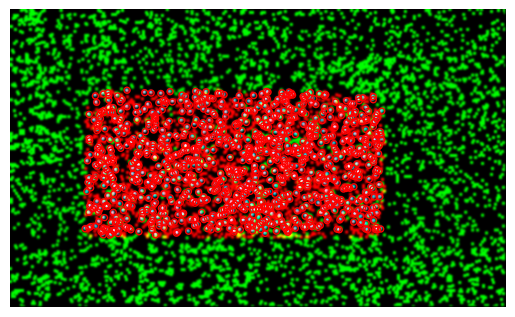

Working on: Pos00113

[  5. -19.]
Matched clusters before transform update:  930
Matched clusters after transform update:  975
Out of  2208  smFRET peaks and  5225  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


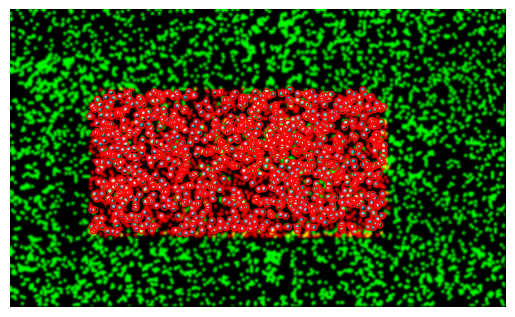

Working on: Pos00114

[  4. -17.]
Matched clusters before transform update:  876
Matched clusters after transform update:  900
Out of  2091  smFRET peaks and  4823  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  18


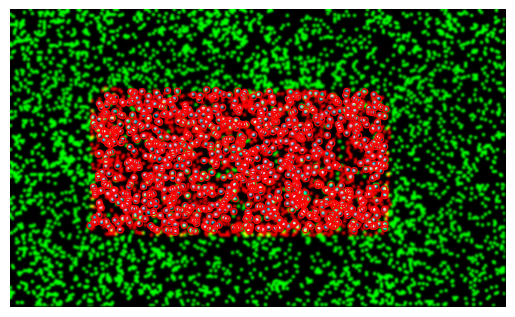

Working on: Pos00115

[  4. -16.]
Matched clusters before transform update:  826
Matched clusters after transform update:  880
Out of  2119  smFRET peaks and  5001  clusters
Percentage of matched smFRET peaks:  41
Percentage of matched clusters:  17


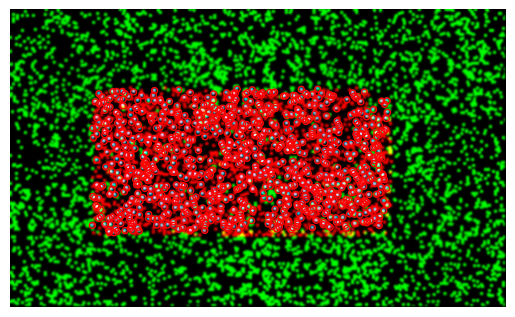

Working on: Pos00116

[  4. -16.]
Matched clusters before transform update:  916
Matched clusters after transform update:  934
Out of  2159  smFRET peaks and  5251  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  17


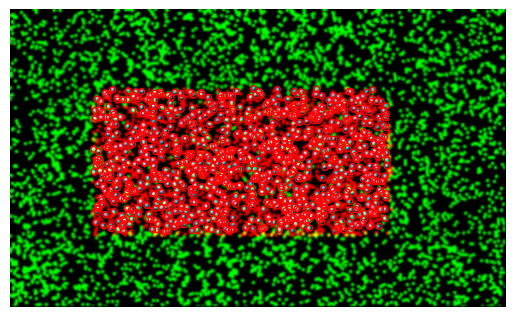

Working on: Pos00117

[  4. -14.]
Matched clusters before transform update:  890
Matched clusters after transform update:  940
Out of  2092  smFRET peaks and  5030  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


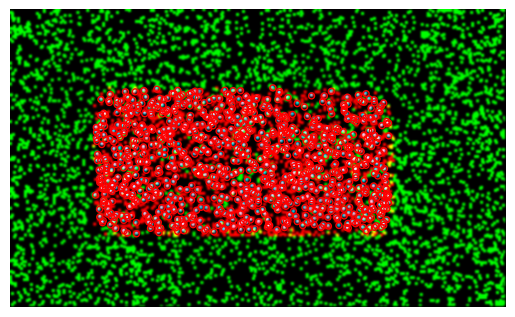

Working on: Pos00118

[  5. -13.]
Matched clusters before transform update:  910
Matched clusters after transform update:  961
Out of  2103  smFRET peaks and  5185  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  18


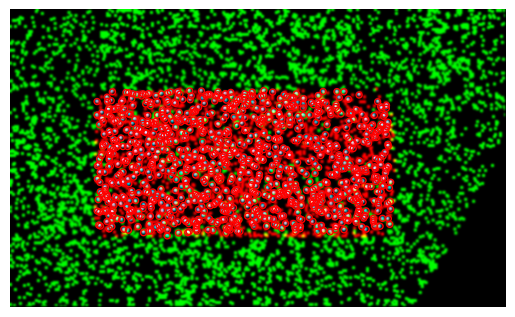

Working on: Pos00145

[ 3. -9.]
Matched clusters before transform update:  991
Matched clusters after transform update:  1029
Out of  2182  smFRET peaks and  5414  clusters
Percentage of matched smFRET peaks:  47
Percentage of matched clusters:  19


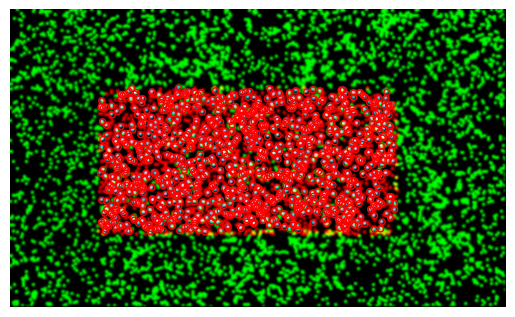

Working on: Pos00146

[  3. -12.]
Matched clusters before transform update:  848
Matched clusters after transform update:  888
Out of  2132  smFRET peaks and  4909  clusters
Percentage of matched smFRET peaks:  41
Percentage of matched clusters:  18


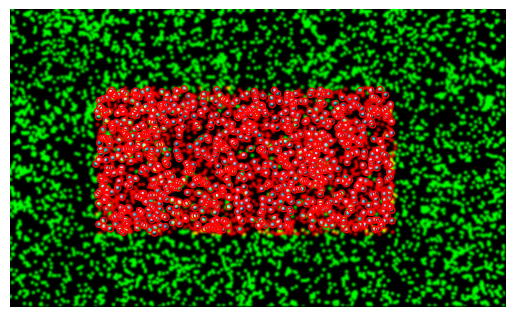

Working on: Pos00147

[  3. -11.]
Matched clusters before transform update:  929
Matched clusters after transform update:  1007
Out of  2142  smFRET peaks and  5340  clusters
Percentage of matched smFRET peaks:  47
Percentage of matched clusters:  18


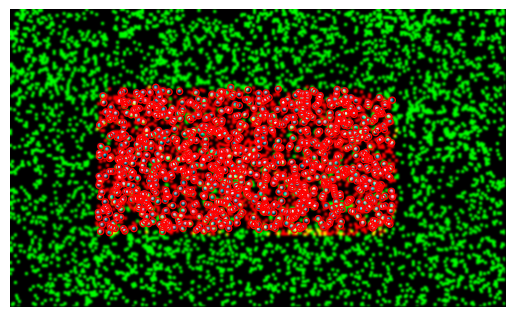

Working on: Pos00148

[  3. -13.]
Matched clusters before transform update:  833
Matched clusters after transform update:  863
Out of  2058  smFRET peaks and  5178  clusters
Percentage of matched smFRET peaks:  41
Percentage of matched clusters:  16


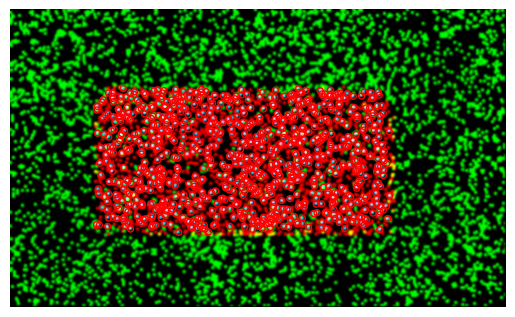

Working on: Pos00149

[  3. -14.]
Matched clusters before transform update:  876
Matched clusters after transform update:  938
Out of  2116  smFRET peaks and  5213  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


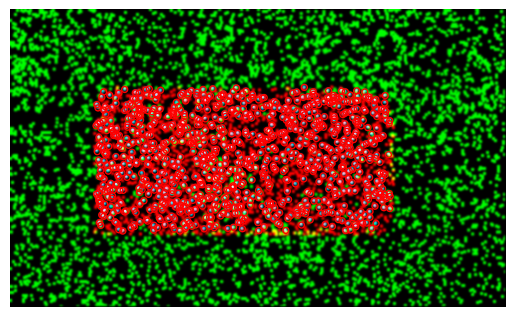

Working on: Pos00150

[  4. -16.]
Matched clusters before transform update:  889
Matched clusters after transform update:  940
Out of  2125  smFRET peaks and  5405  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


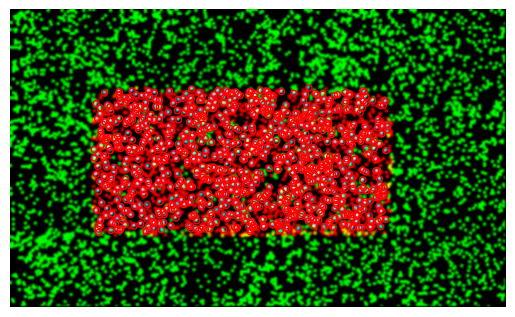

Working on: Pos00151

[  4. -18.]
Matched clusters before transform update:  919
Matched clusters after transform update:  940
Out of  2104  smFRET peaks and  5302  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


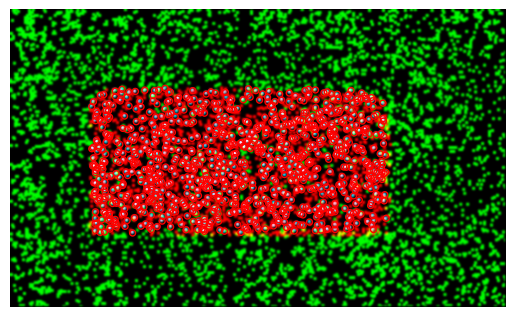

Working on: Pos00156

[  4. -21.]
Matched clusters before transform update:  974
Matched clusters after transform update:  994
Out of  2181  smFRET peaks and  5707  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  17


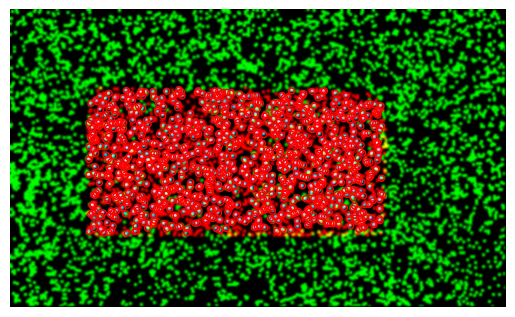

Working on: Pos00157

[  3. -18.]
Matched clusters before transform update:  930
Matched clusters after transform update:  984
Out of  2147  smFRET peaks and  5521  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  17


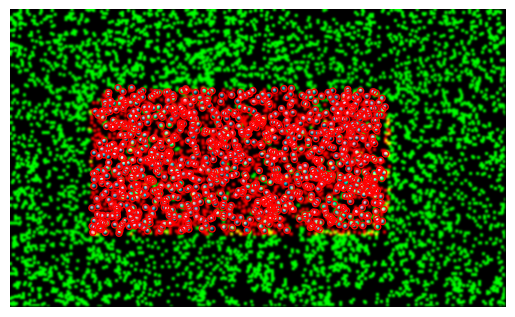

Working on: Pos00158

[  3. -16.]
Matched clusters before transform update:  966
Matched clusters after transform update:  1012
Out of  2214  smFRET peaks and  5446  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  18


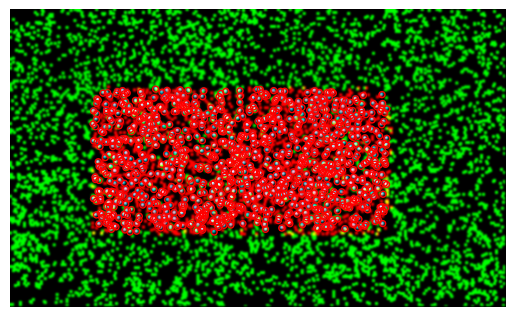

Working on: Pos00159

[  4. -16.]
Matched clusters before transform update:  904
Matched clusters after transform update:  996
Out of  2128  smFRET peaks and  5315  clusters
Percentage of matched smFRET peaks:  46
Percentage of matched clusters:  18


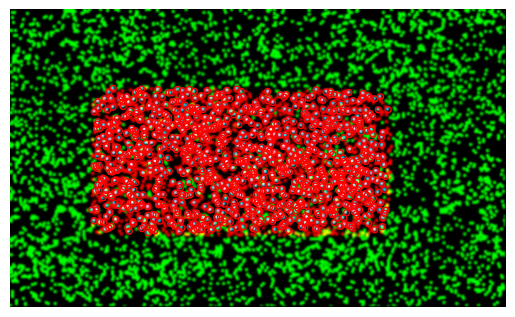

Working on: Pos00160

[  3. -16.]
Matched clusters before transform update:  996
Matched clusters after transform update:  1033
Out of  2261  smFRET peaks and  5402  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  19


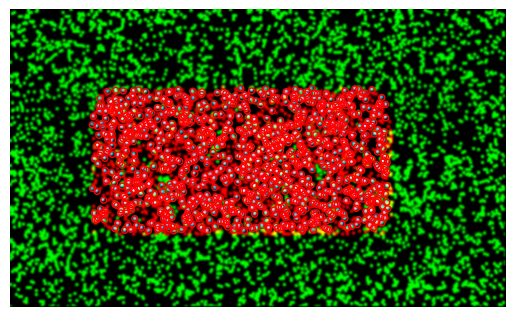

Working on: Pos00161

[  4. -15.]
Matched clusters before transform update:  915
Matched clusters after transform update:  957
Out of  2186  smFRET peaks and  5143  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  18


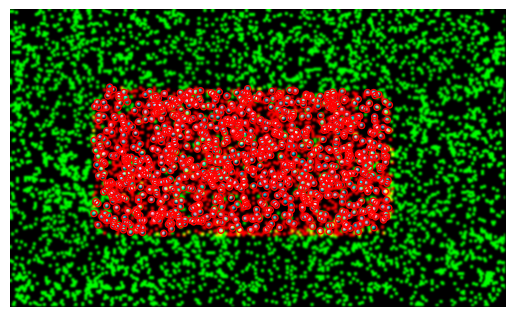

Working on: Pos00162

[  4. -13.]
Matched clusters before transform update:  934
Matched clusters after transform update:  964
Out of  2168  smFRET peaks and  5552  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


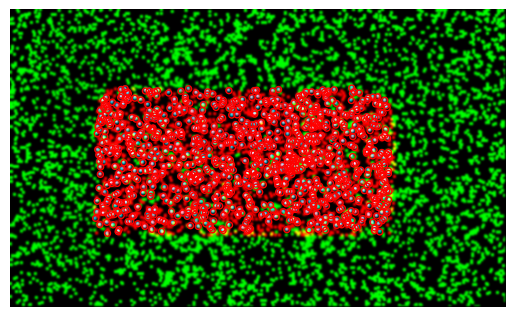

Working on: Pos00189

[  2. -10.]
Matched clusters before transform update:  928
Matched clusters after transform update:  986
Out of  2217  smFRET peaks and  5777  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


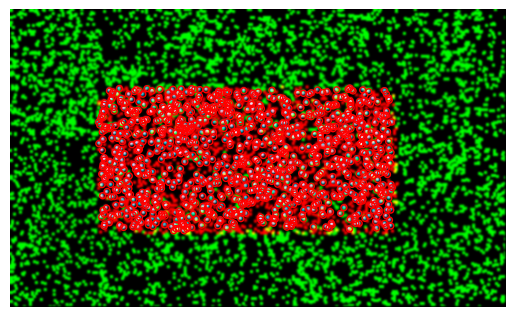

Working on: Pos00190

[  2. -12.]
Matched clusters before transform update:  947
Matched clusters after transform update:  986
Out of  2248  smFRET peaks and  5203  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  18


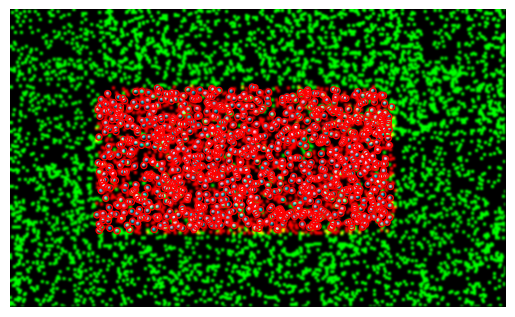

Working on: Pos00191

[  2. -12.]
Matched clusters before transform update:  864
Matched clusters after transform update:  911
Out of  2107  smFRET peaks and  5071  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  17


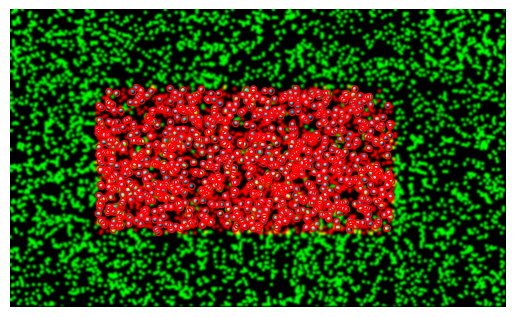

Working on: Pos00192

[  2. -13.]
Matched clusters before transform update:  880
Matched clusters after transform update:  917
Out of  2221  smFRET peaks and  4892  clusters
Percentage of matched smFRET peaks:  41
Percentage of matched clusters:  18


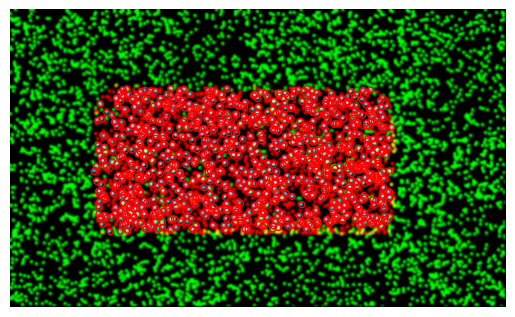

Working on: Pos00193

[  2. -13.]
Matched clusters before transform update:  1002
Matched clusters after transform update:  1025
Out of  2240  smFRET peaks and  5461  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  18


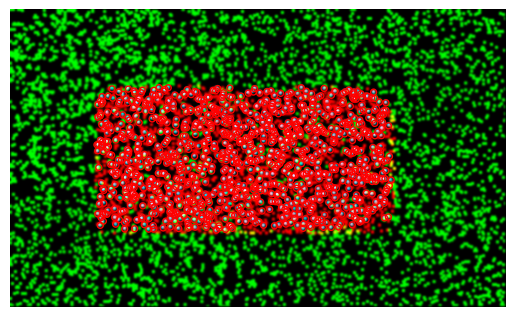

Working on: Pos00194

[  2. -16.]
Matched clusters before transform update:  984
Matched clusters after transform update:  1038
Out of  2082  smFRET peaks and  5906  clusters
Percentage of matched smFRET peaks:  49
Percentage of matched clusters:  17


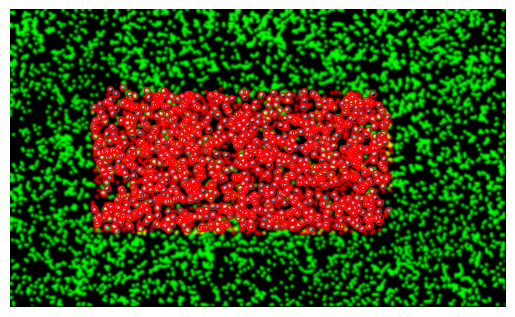

Working on: Pos00195

[  2. -18.]
Matched clusters before transform update:  965
Matched clusters after transform update:  978
Out of  2123  smFRET peaks and  5892  clusters
Percentage of matched smFRET peaks:  46
Percentage of matched clusters:  16


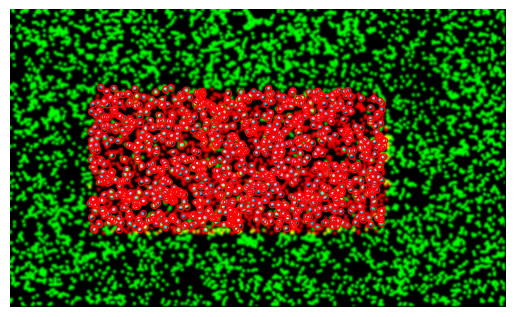

Working on: Pos00200

[  2. -22.]
Matched clusters before transform update:  1029
Matched clusters after transform update:  1074
Out of  2145  smFRET peaks and  5946  clusters
Percentage of matched smFRET peaks:  50
Percentage of matched clusters:  18


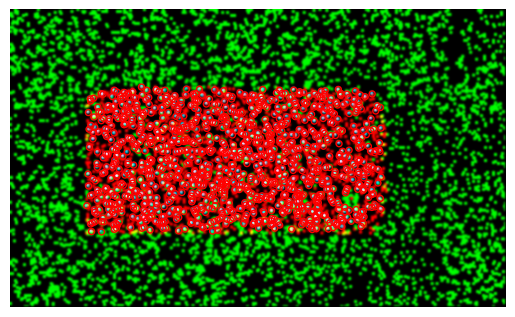

Working on: Pos00201

[  3. -19.]
Matched clusters before transform update:  1019
Matched clusters after transform update:  1070
Out of  2184  smFRET peaks and  5757  clusters
Percentage of matched smFRET peaks:  48
Percentage of matched clusters:  18


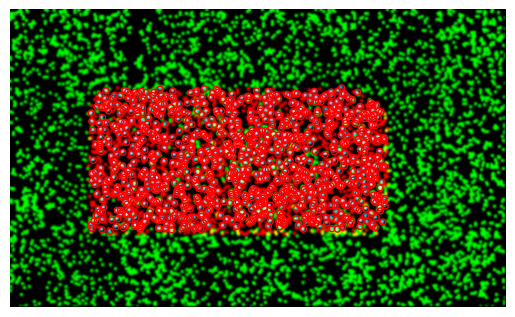

Working on: Pos00202

[  3. -17.]
Matched clusters before transform update:  945
Matched clusters after transform update:  983
Out of  2182  smFRET peaks and  5423  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  18


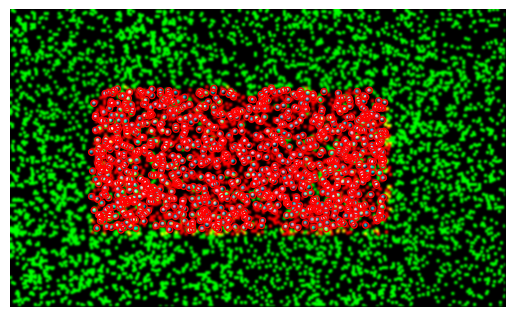

Working on: Pos00203

[  2. -17.]
Matched clusters before transform update:  921
Matched clusters after transform update:  975
Out of  2196  smFRET peaks and  4945  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  19


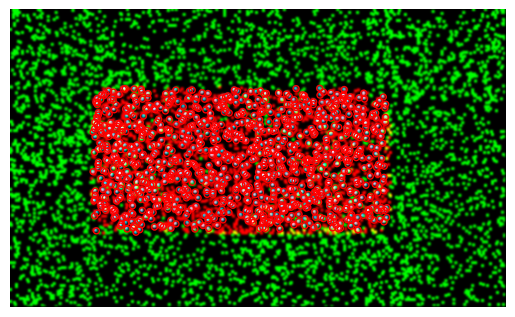

Working on: Pos00204

[  3. -16.]
Matched clusters before transform update:  891
Matched clusters after transform update:  957
Out of  2209  smFRET peaks and  4932  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  19


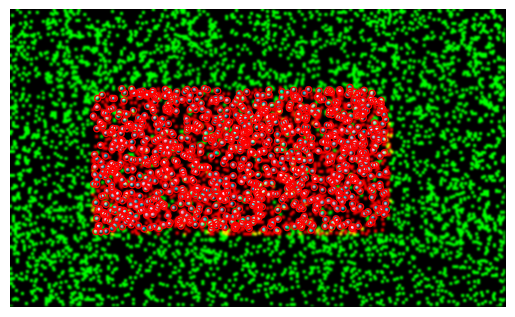

Working on: Pos00205

[  3. -16.]
Matched clusters before transform update:  950
Matched clusters after transform update:  991
Out of  2253  smFRET peaks and  5386  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  18


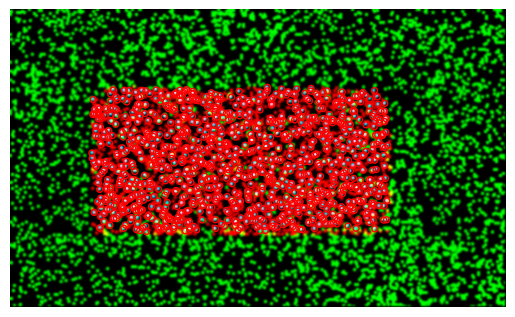

Working on: Pos00206

[  3. -14.]
Matched clusters before transform update:  980
Matched clusters after transform update:  1010
Out of  2265  smFRET peaks and  5726  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


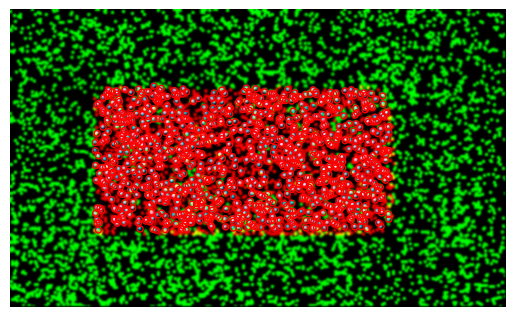

Working on: Pos00233

[  1. -10.]
Matched clusters before transform update:  875
Matched clusters after transform update:  936
Out of  2089  smFRET peaks and  5262  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


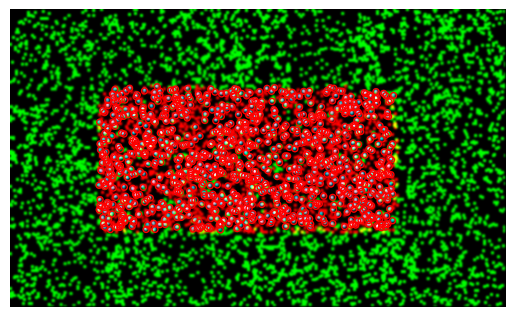

Working on: Pos00234

[  2. -13.]
Matched clusters before transform update:  913
Matched clusters after transform update:  988
Out of  2149  smFRET peaks and  5045  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  19


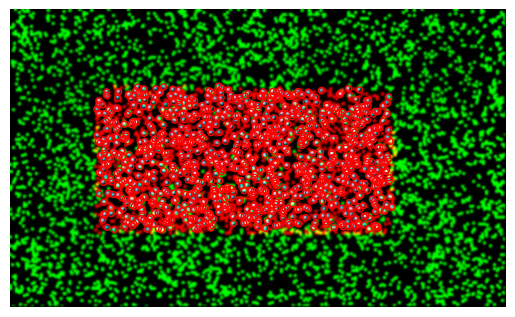

Working on: Pos00235

[  2. -12.]
Matched clusters before transform update:  904
Matched clusters after transform update:  953
Out of  2193  smFRET peaks and  5102  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  18


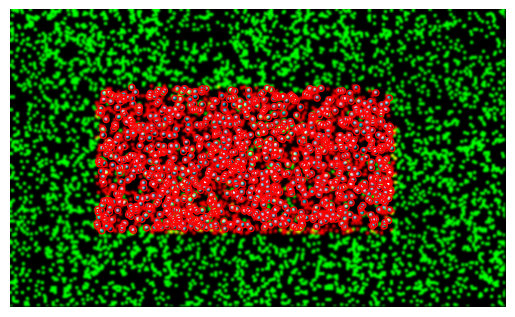

Working on: Pos00236

[  1. -13.]
Matched clusters before transform update:  911
Matched clusters after transform update:  961
Out of  2154  smFRET peaks and  5078  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


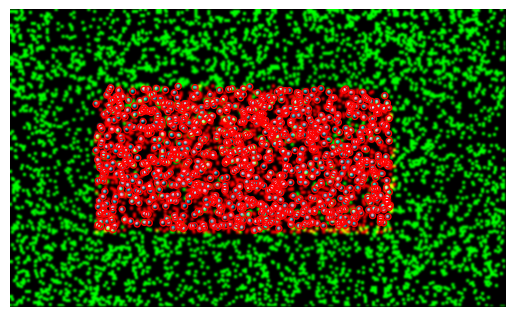

Working on: Pos00237

[  1. -14.]
Matched clusters before transform update:  903
Matched clusters after transform update:  937
Out of  2107  smFRET peaks and  4947  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


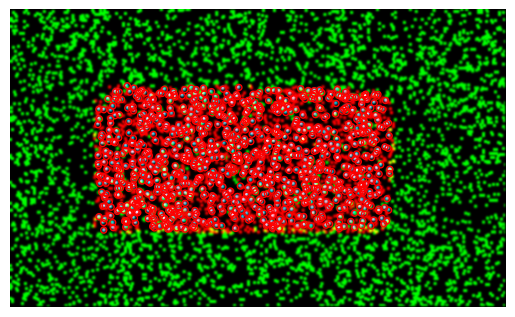

Working on: Pos00238

[  1. -15.]
Matched clusters before transform update:  949
Matched clusters after transform update:  971
Out of  2206  smFRET peaks and  5366  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


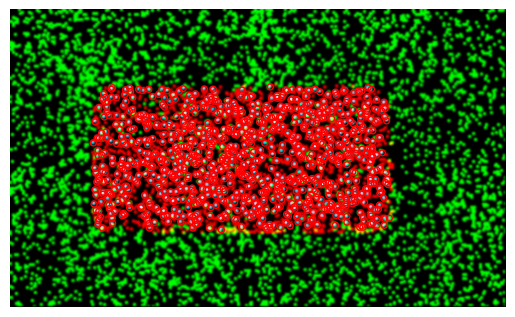

Working on: Pos00239

[  1. -18.]
Matched clusters before transform update:  921
Matched clusters after transform update:  926
Out of  2107  smFRET peaks and  5544  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  16


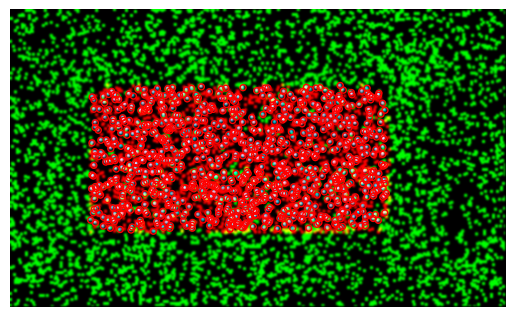

Working on: Pos00244

[  0. -21.]
Matched clusters before transform update:  910
Matched clusters after transform update:  937
Out of  2116  smFRET peaks and  5310  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


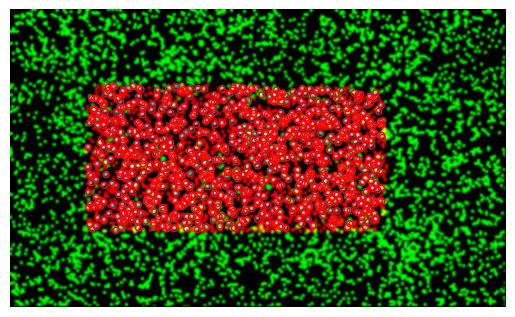

Working on: Pos00245

[  1. -19.]
Matched clusters before transform update:  889
Matched clusters after transform update:  933
Out of  2085  smFRET peaks and  5322  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


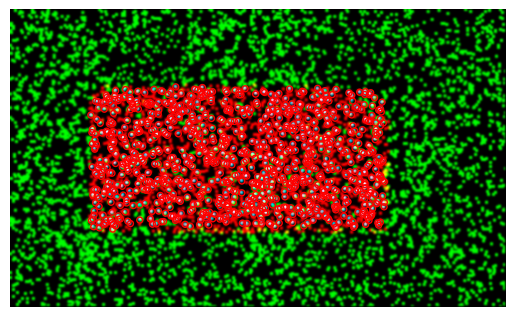

Working on: Pos00246

[  2. -17.]
Matched clusters before transform update:  909
Matched clusters after transform update:  949
Out of  2114  smFRET peaks and  5004  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


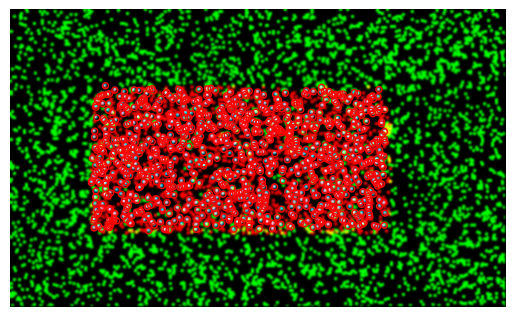

Working on: Pos00247

[  1. -16.]
Matched clusters before transform update:  879
Matched clusters after transform update:  929
Out of  2060  smFRET peaks and  5397  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  17


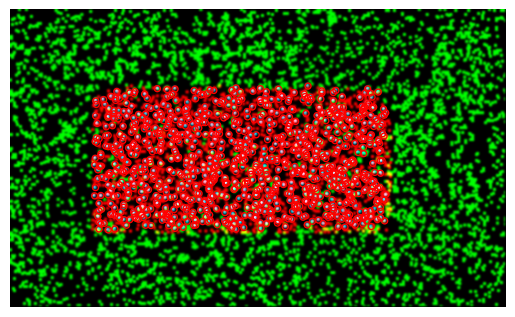

Working on: Pos00248

[  1. -16.]
Matched clusters before transform update:  947
Matched clusters after transform update:  1002
Out of  2172  smFRET peaks and  5045  clusters
Percentage of matched smFRET peaks:  46
Percentage of matched clusters:  19


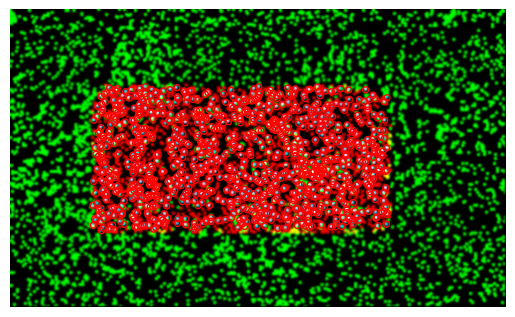

Working on: Pos00249

[  1. -15.]
Matched clusters before transform update:  884
Matched clusters after transform update:  917
Out of  2045  smFRET peaks and  4757  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  19


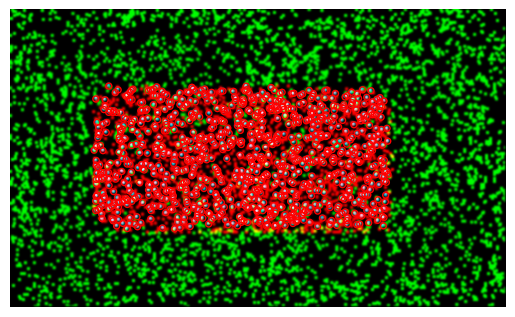

Working on: Pos00250

[  1. -13.]
Matched clusters before transform update:  892
Matched clusters after transform update:  925
Out of  2100  smFRET peaks and  4994  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


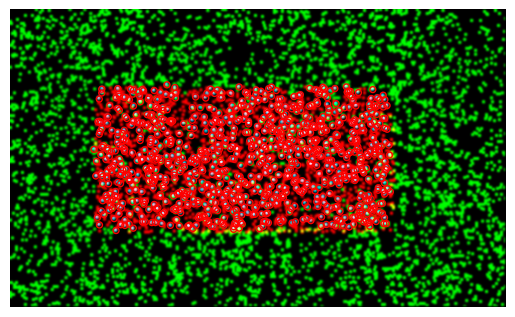

Working on: Pos00277

[-1. -9.]
Matched clusters before transform update:  850
Matched clusters after transform update:  900
Out of  2010  smFRET peaks and  4767  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


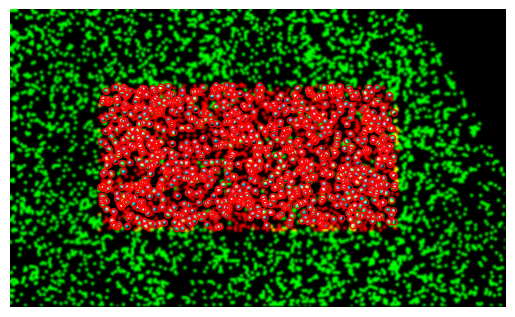

Working on: Pos00278

[  0. -11.]
Matched clusters before transform update:  855
Matched clusters after transform update:  890
Out of  2042  smFRET peaks and  4979  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  17


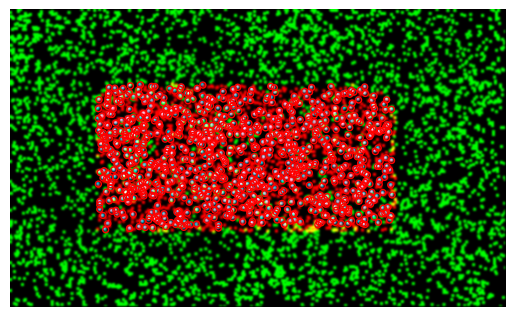

Working on: Pos00279

[  0. -12.]
Matched clusters before transform update:  860
Matched clusters after transform update:  885
Out of  2036  smFRET peaks and  5174  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  17


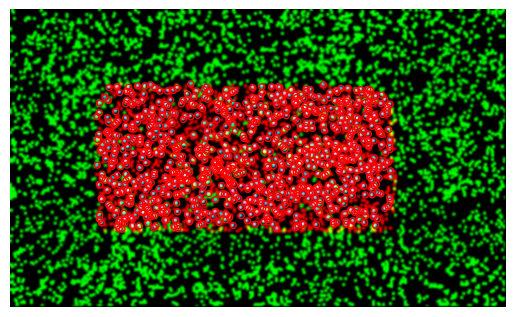

Working on: Pos00280

[  0. -13.]
Matched clusters before transform update:  893
Matched clusters after transform update:  922
Out of  2066  smFRET peaks and  5038  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


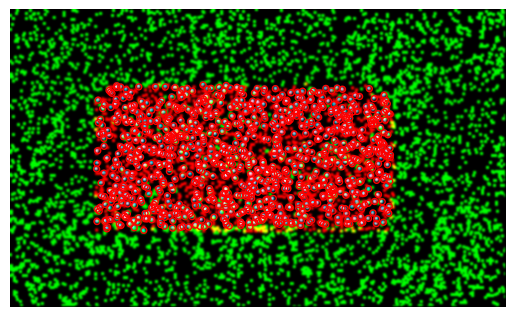

Working on: Pos00281

[  0. -13.]
Matched clusters before transform update:  841
Matched clusters after transform update:  866
Out of  2053  smFRET peaks and  4828  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  17


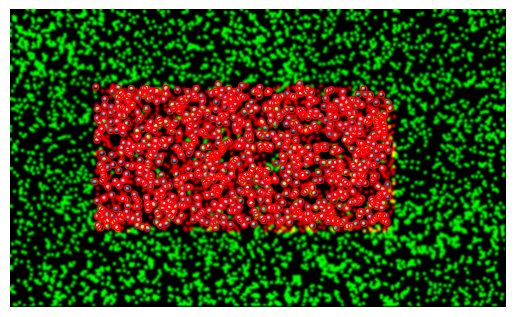

Working on: Pos00282

[ -1. -16.]
Matched clusters before transform update:  879
Matched clusters after transform update:  901
Out of  2048  smFRET peaks and  5057  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  17


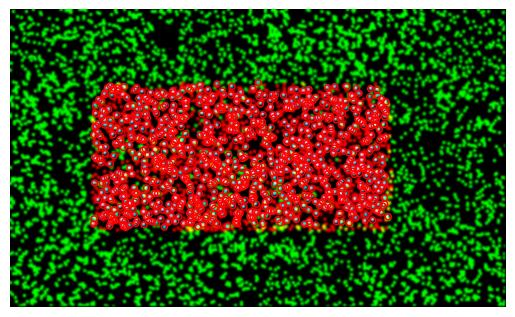

Working on: Pos00283

[ -2. -18.]
Matched clusters before transform update:  893
Matched clusters after transform update:  932
Out of  2059  smFRET peaks and  5351  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  17


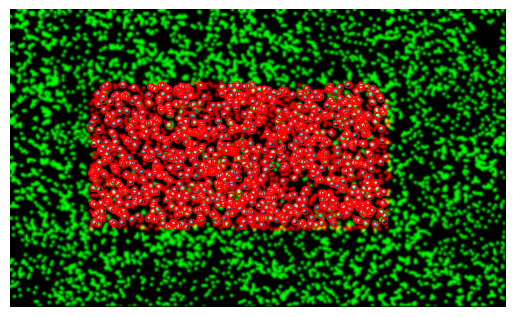

Working on: Pos00288

[ -3. -21.]
Matched clusters before transform update:  879
Matched clusters after transform update:  950
Out of  2104  smFRET peaks and  5160  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  18


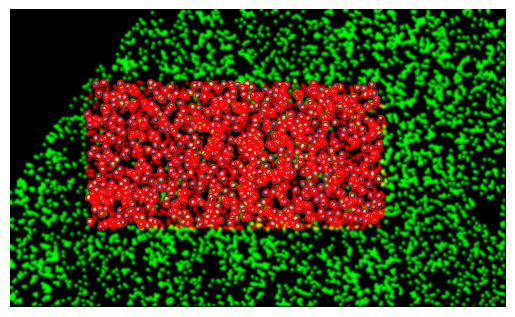

Working on: Pos00289

[ -2. -19.]
Matched clusters before transform update:  992
Matched clusters after transform update:  1012
Out of  2136  smFRET peaks and  5309  clusters
Percentage of matched smFRET peaks:  47
Percentage of matched clusters:  19


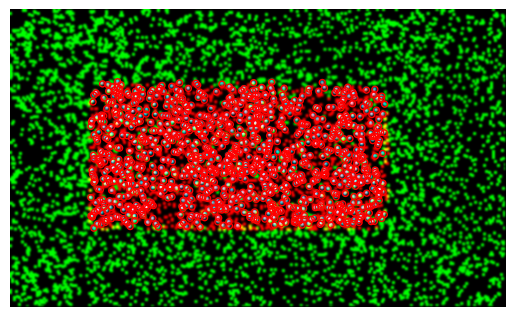

Working on: Pos00290

[ -1. -17.]
Matched clusters before transform update:  869
Matched clusters after transform update:  887
Out of  2099  smFRET peaks and  4837  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  18


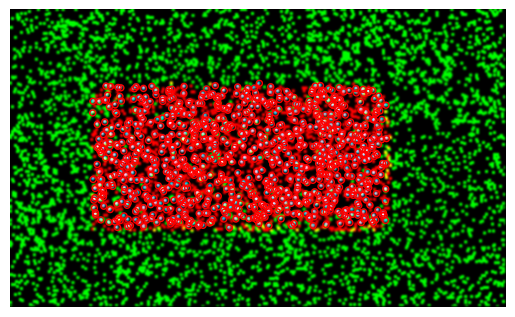

Working on: Pos00291

[ -1. -16.]
Matched clusters before transform update:  875
Matched clusters after transform update:  915
Out of  2145  smFRET peaks and  4808  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  19


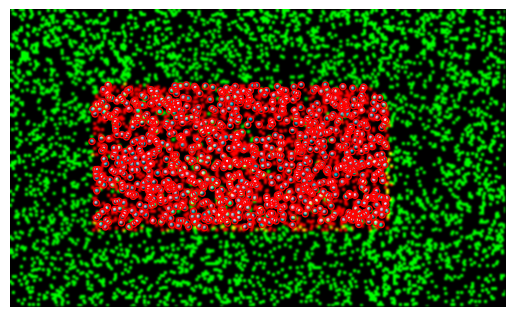

Working on: Pos00292

[ -1. -15.]
Matched clusters before transform update:  900
Matched clusters after transform update:  946
Out of  2128  smFRET peaks and  4976  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  19


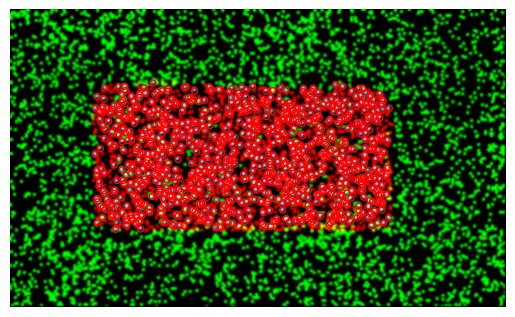

Working on: Pos00293

[ -1. -14.]
Matched clusters before transform update:  902
Matched clusters after transform update:  945
Out of  2092  smFRET peaks and  4975  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  18


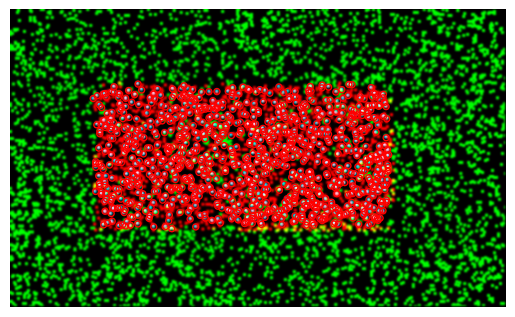

Working on: Pos00294

[ -2. -12.]
Matched clusters before transform update:  885
Matched clusters after transform update:  930
Out of  2148  smFRET peaks and  4052  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  22


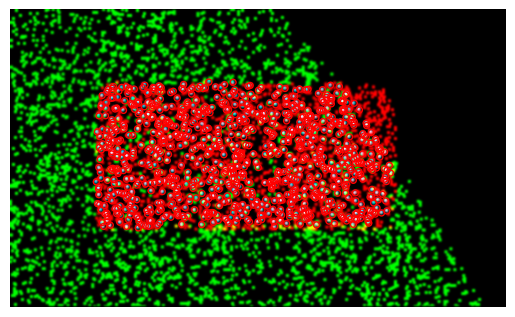

Working on: Pos00321

[-4. -8.]
Matched clusters before transform update:  469
Matched clusters after transform update:  498
Out of  2256  smFRET peaks and  2538  clusters
Percentage of matched smFRET peaks:  22
Percentage of matched clusters:  19


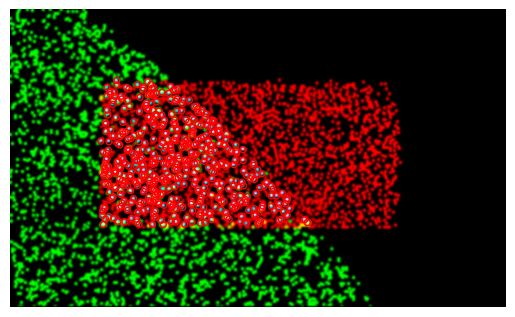

Working on: Pos00322

[ -3. -10.]
Matched clusters before transform update:  848
Matched clusters after transform update:  924
Out of  2146  smFRET peaks and  4776  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  19


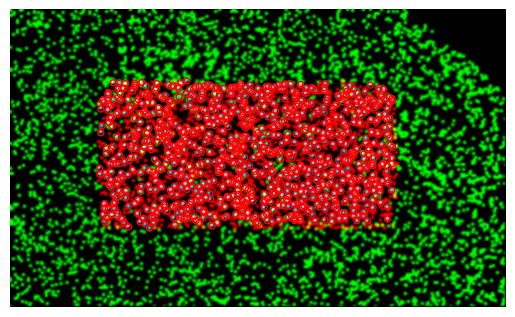

Working on: Pos00323

[ -3. -11.]
Matched clusters before transform update:  924
Matched clusters after transform update:  962
Out of  2276  smFRET peaks and  4904  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  19


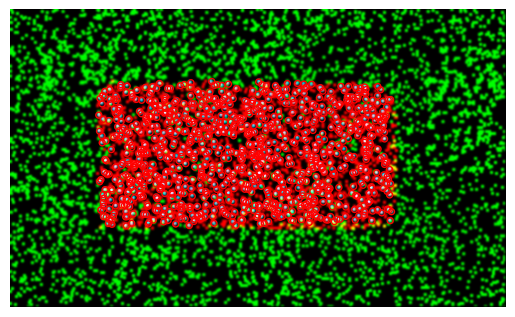

Working on: Pos00324

[ -3. -13.]
Matched clusters before transform update:  948
Matched clusters after transform update:  968
Out of  2229  smFRET peaks and  5169  clusters
Percentage of matched smFRET peaks:  43
Percentage of matched clusters:  18


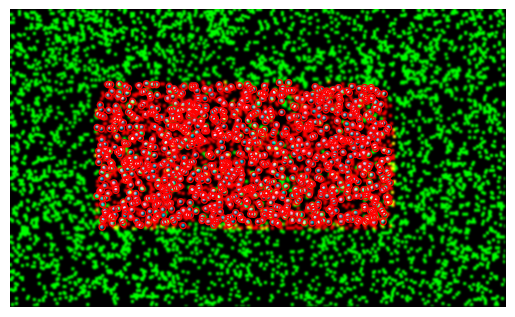

Working on: Pos00325

[ -3. -13.]
Matched clusters before transform update:  912
Matched clusters after transform update:  956
Out of  2092  smFRET peaks and  4956  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  19


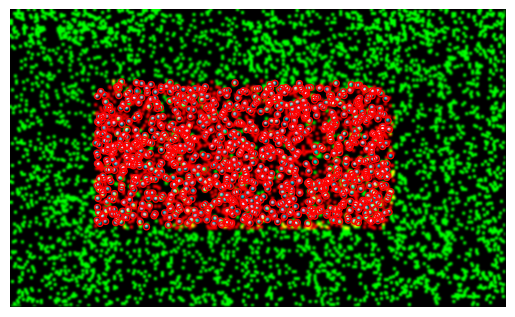

Working on: Pos00326

[ -4. -16.]
Matched clusters before transform update:  866
Matched clusters after transform update:  877
Out of  2098  smFRET peaks and  5161  clusters
Percentage of matched smFRET peaks:  41
Percentage of matched clusters:  16


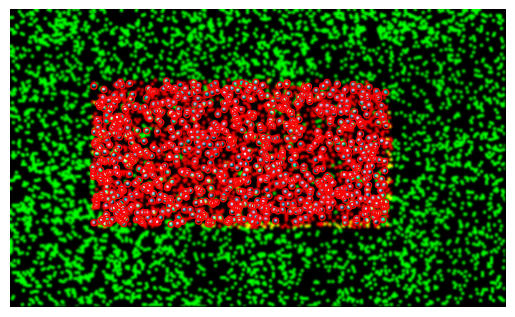

Working on: Pos00327

[ -5. -19.]
Matched clusters before transform update:  690
Matched clusters after transform update:  692
Out of  2170  smFRET peaks and  3726  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  18


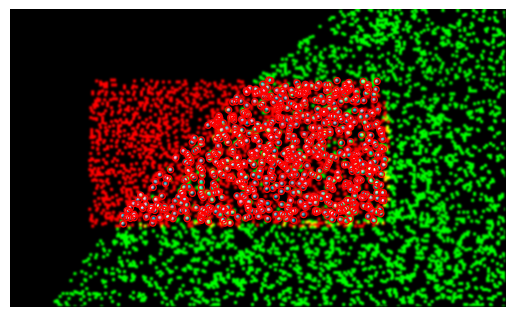

Working on: Pos00332

[ 77. 136.]
Matched clusters before transform update:  503
Matched clusters after transform update:  683
Out of  2217  smFRET peaks and  1441  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  47


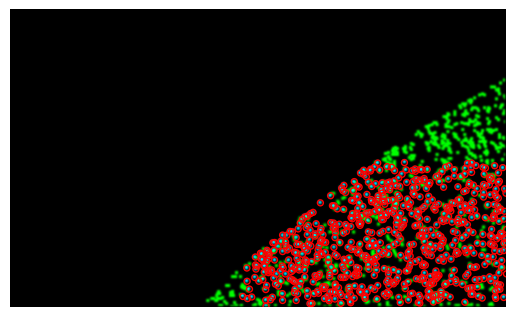

Working on: Pos00333

[ -5. -20.]
Matched clusters before transform update:  922
Matched clusters after transform update:  939
Out of  2128  smFRET peaks and  4347  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  21


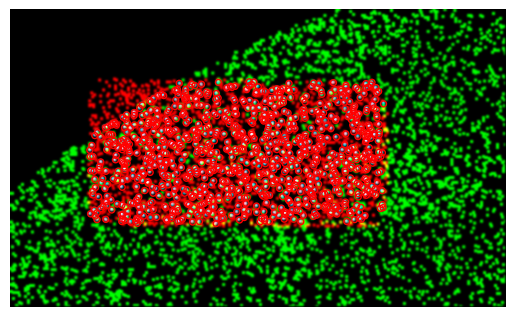

Working on: Pos00334

[ -4. -17.]
Matched clusters before transform update:  902
Matched clusters after transform update:  939
Out of  2199  smFRET peaks and  5087  clusters
Percentage of matched smFRET peaks:  42
Percentage of matched clusters:  18


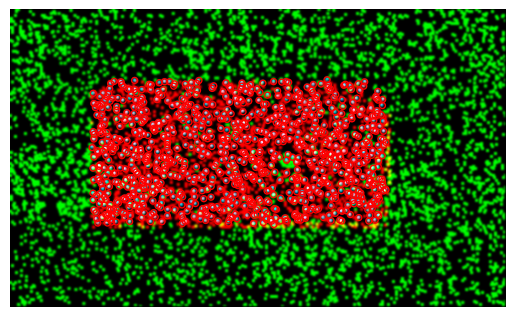

Working on: Pos00335

[ -4. -16.]
Matched clusters before transform update:  943
Matched clusters after transform update:  954
Out of  2126  smFRET peaks and  5404  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  17


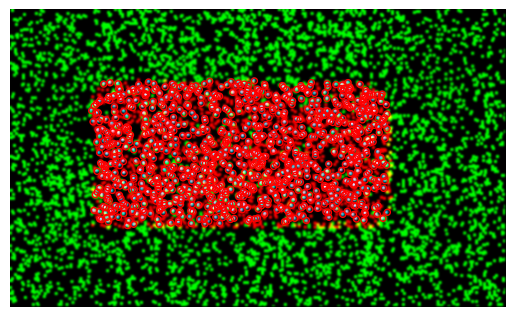

Working on: Pos00336

[ -4. -15.]
Matched clusters before transform update:  892
Matched clusters after transform update:  924
Out of  2100  smFRET peaks and  5095  clusters
Percentage of matched smFRET peaks:  44
Percentage of matched clusters:  18


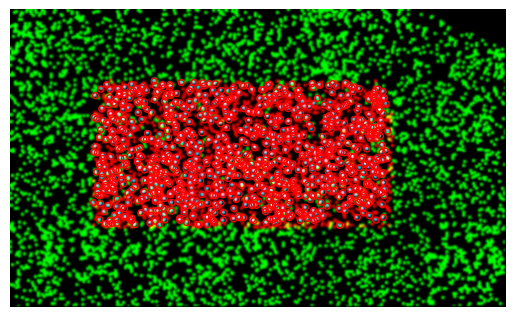

Working on: Pos00337

[ -4. -13.]
Matched clusters before transform update:  789
Matched clusters after transform update:  857
Out of  2176  smFRET peaks and  3622  clusters
Percentage of matched smFRET peaks:  39
Percentage of matched clusters:  23


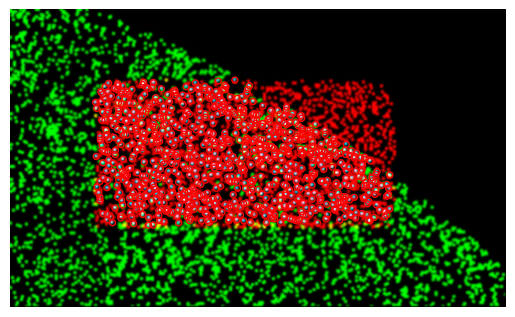

Working on: Pos00338

[  39. -110.]
Matched clusters before transform update:  221
Matched clusters after transform update:  292
Out of  2162  smFRET peaks and  805  clusters
Percentage of matched smFRET peaks:  13
Percentage of matched clusters:  36


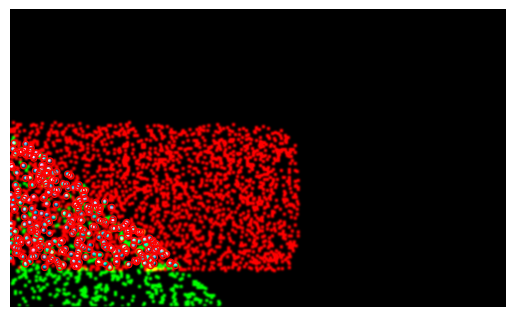

In [33]:
# MAIN CYCLE
os.makedirs(os.path.join(current_direct, 'QC_composites'), exist_ok=True)
os.makedirs(os.path.join(current_direct, 'QC_composites_raw'), exist_ok=True)
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
#     path1 = os.path.join(beads_dir,pos+'.tiff')
#     path1 = os.path.join(path_smFRET,pos,'A_Red','img_000000000.tiff')
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')
    else:
        continue
        
    if (not os.path.exists(os.path.join(current_direct, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []
        
        processed_pos.append(pos)
        pos_direct = os.path.join(current_direct, pos)
        os.makedirs(pos_direct, exist_ok=True)
        log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
        log_file.write('Working on: '+ pos+'\n')
        print('Working on: '+ pos+'\n')
        FRET_coord = []
        seq_coord = []
        point = []
        counter = 0
        rb_rad = 10
#         img_beads_F = io.imread(path1) #reading the stack of images
#         if len(img_beads_F.shape) == 3:
#             if img_beads_F.shape[0] == 512: # sometimes slice number is the first dimension, sometimes the third
#                 img_beads_F = np.mean(img_beads_F, axis = 2) #averaging by the stack
#             else:
#                 img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
             
#         img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
#         img_beads_F = img_beads_F [256:512, 0:512]
#         img_beads_F = img_beads_F - rolling_ball(img_beads_F, radius=rb_rad)
#         image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
#         image_array_F = img_as_ubyte(image_array_F)
#         #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
        #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

#         image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)
        
        idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
        X_c = [posX_res[i] for i in idx]
        Y_c = [posY_res[i] for i in idx]

        X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
        point.append(X_c)
        point.append(Y_c)
        point = np.array(point)
#         image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
#         image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
#         image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
        x_FQ = [x_coord[i] for i in idx]
        y_FQ = [y_coord[i] for i in idx]
        seq_t = [sequence[i] for i in idx]
        if len(seq_t)<100:
            log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
            continue

        #print(image_array)

        #reading by cv2 to make possible circles in color
        #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
        #img_array = img_as_int(img)
        # displaying the image
        # setting mouse handler for the image
        # and calling the click_event() function
#         image_seq = Image.fromarray(image_array_seq_t)
#         image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

#         image_fastq = Image.fromarray(image_array_FQ_t)
#         image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

#         v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
#         if v_max == 0: v_max = np.max(image_array_seq_t)  

#         # Calculating the shift between the FASTQ and cluster images using cross-correlation
#         shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
#         shift = shift[0]
#         print(shift)
#         # Translation of the FASTQ sequences in the FOV to match the cluster image
        x_FQ = np.subtract(x_FQ,X_c)
        y_FQ = np.subtract(y_FQ,Y_c)
#         FQ_shifts.append([X_c-shift[1], Y_c-shift[0]])
#         FQ_shifts_pos.append(pos)
        
#         MAX_centers = blob_detection(
#             image_array_max_t,
#             min_sigma=1,
#             max_sigma=10,
#             threshold=0.0001
#         )
#         FQ_centers_all = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
#         res, idx = count_nearest_pts(FQ_centers_all, MAX_centers, 2)
#         FQ_centers_all1 = FQ_centers_all[idx[np.where(res != inf)]]
#         MAX_centers1 = MAX_centers[np.where(res != inf)]
#         print(FQ_centers_all1)
#         print(MAX_centers1)

#         trFQtoMAX = transform.estimate_transform("similarity", src=FQ_centers_all1, dst=MAX_centers1)

#         temp = trFQtoMAX(FQ_centers_all)
#         x_FQ = temp[:,0];
#         y_FQ = temp[:,1];

        fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
        fastq_image1.save(os.path.join(pos_direct,pos+'_FQ.png'))
#         max_image = generate_img(MAX_centers[:,1],MAX_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
#         max_image.save(os.path.join(pos_direct,pos+'_MAX_seq_CoM.png'))
#         max_image = Image.fromarray(image_array_max_t)
#         max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))
#         fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
#         fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
#         fig, ax = plt.subplots()
#         ax.imshow(fastq_image1)
#         plt.show()


        
        
#         # Calculating the transformation based on automatically-selected beads
#         movie_centers = blob_detection(
#             np.asarray(img_beads_F),
#             min_sigma=1,
#             max_sigma=10,
#             threshold=0.1 # was 0.003 before 2024-01-30
#         )

#         seq_centers = blob_detection(
#             image_array_seq_t,
#             min_sigma=1,
#             max_sigma=10,
#             threshold=0.0005, # Was 0.00001 for 19/07/2022 and 0.0005
#          )
#         beadsOK = False

            
#         print(beadsOK)    
        # Reading the smFRET movie
#             path_smFRET_file = os.path.join(path_smFRET,pos+'.tiff')
        

        img_smFRET = io.imread(path_smFRET_file)

        # Averaging the first 10 frames to select peaks
        if ALEX:
#             img_t = np.mean(img_smFRET[green_frames,::], axis = 0)
            img_t = np.mean(img_smFRET[red_frames,::], axis = 0)
        else:
            img_t = np.mean(img_smFRET[0:10,::], axis = 0)
        img_t = img_t.astype("ushort")
        rb_rad = 10

        red = img_t[256:,:]
        green = img_t[:256,:]
        red = red - rolling_ball(red, radius=rb_rad)
        green = green - rolling_ball(green, radius=rb_rad)
        green = transform.warp(green,tr_R2G, preserve_range = True)
        combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
#         fig, ax = plt.subplots()
#         ax.imshow(combined)
        blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=30) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
        CM = []
        r = 3
        [h,w] = red.shape
        n_frames = img_smFRET.shape[0]
        FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        
        for i, blob in enumerate(blobs_log):
            x, y, d = blob
            if x>r and x<(h-r) and y>r and y<(w-r):
                temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
                CM.append(np.flip(np.add(temp, [x-r,y-r])))

#                 c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
#                 ax.add_patch(c)
#         ax.set_axis_off()
#         plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
#         plt.show()
        smFRET_centers = np.array(CM)
#         res, idx = count_nearest_pts(rough_tr(movie_centers), seq_centers, 8)
#         movie_centers1 = movie_centers[idx[np.where(res != inf)]]
#         seq_centers1 = seq_centers[np.where(res != inf)]
        
#         if not beadsOK:
            # Calculating the shift between the FASTQ and cluster images using cross-correlation
        smFRET_centers_tr = apriori_tr(smFRET_centers)
        smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
        fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
#         fig, ax = plt.subplots()
#         ax.imshow(smFRET_centers_tr_image_array)
#         plt.show()
        image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
        image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_tr.tif"))

#         fig, ax = plt.subplots()
#         ax.imshow(fastq_image_lib_array)
#         plt.show()
        image_smFRET_tr = Image.fromarray(fastq_image_lib_array)
        image_smFRET_tr.save(os.path.join(pos_direct, pos + "_FQ_peaks.tif"))

        shift = phase_cross_correlation(fastq_image_lib_array,smFRET_centers_tr_image_array)
        shift = shift[0]
        print(shift)

        rough_tr1 = copy.deepcopy(apriori_tr)
        dx = apriori_tr.params[0,2] + shift[1] # Check sign!
        dy = apriori_tr.params[1,2] + shift[0]
        rough_tr1.params[0,2] = dx
        rough_tr1.params[1,2] = dy

        np.save(os.path.join(pos_direct, pos + "_auto_bead_tr"), rough_tr1)

        smFRET_centers_tr = rough_tr1(smFRET_centers)
        smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
        fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
#         fig, ax = plt.subplots()
#         ax.imshow(smFRET_centers_tr_image_array)
#         plt.show()
        image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
        image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_upd_tr.tif"))        
        
        res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 2)
        movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
        seq_centers1 = FQ_centers[np.where(res != inf)]

        if seq_centers1.shape[0]<4:
            print('Not enough smFRET peaks (<4)')
            log_file.write('Not enough smFRET peaks (<4)')
            continue

        tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
        tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
        np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
        np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
        log_file.write('Matched clusters before transform update: ' + str(seq_centers1.shape[0])+'\n')
        print('Matched clusters before transform update: ',seq_centers1.shape[0])

        res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 3) # Was 4 for 19/07/2022
        centers_matched = smFRET_centers[idx[np.where(res != inf)]]
        idx_t = np.where(res != inf)
        seq_matched = [seq_t[i] for i in idx_t[0]]
        FQ_centers_matched = FQ_centers[idx_t]
        distances_matched = res[idx_t]

        centers_red = centers_matched
        centers_green = tr_R2G(centers_matched)
        r = 3
        # Weed out positions that are too close to the edge
        idx_t = np.where((centers_red[:,0]>rb) & (centers_red[:,0]<(w-rb)) & (centers_red[:,1]>rb) & (centers_red[:,1]<(h-rb))  & 
                         (centers_green[:,0]>rb) & (centers_green[:,0]<(w-rb)) & (centers_green[:,1]>rb) & (centers_green[:,1]<(h-rb)))
        centers_red = centers_red [idx_t]
        centers_green = centers_green [idx_t]
        distances_matched = distances_matched[idx_t]
        seq_matched = [seq_matched[i] for i in idx_t[0]]
        FQ_centers_matched = FQ_centers_matched[idx_t]
        
        matched_sequences.append(seq_matched)
        matched_centers_red.append(centers_red)
        matched_centers_green.append(centers_green)
        matched_dist.append(distances_matched)
        matched_centers_FQ.append(FQ_centers_matched)
        good_pos.append(pos)
        log_file.write('Matched clusters after transform update: ' + str(len(seq_matched))+'\n')
        log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
        log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
        log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
        print('Matched clusters after transform update: ',len(seq_matched))
        print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
        print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
        print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
        # Saving transformed bead and molecule images for QC
#         img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
#         img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
        img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
        img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
        centers_red_tfd = tr(centers_red)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))

        centers_red_tfd = tr(smFRET_centers)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))

        img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))

        img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))
        
#         Saving a composite image for quick QC
        fig, ax = plt.subplots()
        QC_composite_array = np.zeros([y_border,x_border,3], dtype=np.uint8)
        red_channel = np.asarray(generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(red_channel[75:125,:], (0.5, 99.5))        
        red_channel = exposure.rescale_intensity(red_channel, in_range=tuple(percentiles))
        red_channel = img_as_ubyte(red_channel)

        green_channel = np.asarray(generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(green_channel, (0.5, 99.5))
        green_channel = exposure.rescale_intensity(green_channel, in_range=tuple(percentiles))
        green_channel = img_as_ubyte(green_channel)

        blue_channel = np.asarray(generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(blue_channel, (0.5, 99.5))
        blue_channel = exposure.rescale_intensity(blue_channel, in_range=tuple(percentiles))
        blue_channel = img_as_ubyte(blue_channel)

        QC_composite_array[:,:,0] = red_channel
        QC_composite_array[:,:,1] = green_channel
        QC_composite_array[:,:,2] = blue_channel

        QC_composite = Image.fromarray(QC_composite_array, mode="RGB")
        QC_composite.save(os.path.join(current_direct, 'QC_composites_raw' , pos + "_QC.tif"))

        ax.imshow(QC_composite)
        for blob in FQ_centers_matched:
            c = plt.Circle(blob, 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
        ax.set_axis_off()
        plt.savefig(os.path.join(current_direct, 'QC_composites' , pos + "_QC.png"))
        plt.show()
        

# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green,
    "matched_distances": matched_dist,
    "matched_FASTQ": matched_centers_FQ,
    "FASTQ_shifts": FQ_shifts
}

savemat(os.path.join(current_direct, "good_pos.mat"), mdict1)


In [34]:
print('Number of matched FOVs: ',len(good_pos))

Number of matched FOVs:  103


In [35]:
# print(x_FQ)

In [36]:
# import copy
# apriori_tr = transform.SimilarityTransform()
# apriori_tr.params = np.array([[ 5.98278480e-01, -2.04811207e-03,  0],
#  [ 2.04811207e-03,  5.98278480e-01,  0],
#  [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# # Centering the tranformation to the x_border and y_border
# delta = 0.5*np.subtract([x_border,y_border],apriori_tr([512,256]))
# dx, dy = delta[0]
# apriori_tr.params[0,2] = dx
# apriori_tr.params[1,2] = dy

# # apriori_tr_inv = transform.SimilarityTransform()
# # apriori_tr_inv.params = np.array([[ 1.67127284e+00,  5.72133913e-03,  0],
# #  [-5.72133913e-03,  1.67127284e+00,  0],
# #  [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# # # Centering the tranformation to the x_border and y_border
# # delta = 0.5*np.subtract([512,256],apriori_tr_inv([x_border,y_border]))
# # dx, dy = delta[0]
# # apriori_tr_inv.params[0,2] = dx
# # apriori_tr_inv.params[1,2] = dy

# #         fig, ax = plt.subplots()
# #         ax.imshow(combined)
# #         blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=1000) # Was 1000 for 19/07/2022
# # #             Was 300 for 06/09/2022
# #         CM = []
# #         r = 3
# #         [h,w] = red.shape
# #         n_frames = img_smFRET.shape[0]
# #         FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        
# #         for i, blob in enumerate(blobs_log):
# #             x, y, d = blob
# #             if x>r and x<(h-r) and y>r and y<(w-r):
# #                 temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
# #                 CM.append(np.flip(np.add(temp, [x-r,y-r])))

# #                 c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
# #                 ax.add_patch(c)
# #         ax.set_axis_off()
# #         plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
# #         plt.show()
# smFRET_centers_tr = apriori_tr(smFRET_centers)
# smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
# fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
# fig, ax = plt.subplots()
# ax.imshow(smFRET_centers_tr_image_array)
# plt.show()
# image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
# image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_tr.tif"))

# fig, ax = plt.subplots()
# ax.imshow(fastq_image_lib_array)
# plt.show()
# image_smFRET_tr = Image.fromarray(fastq_image_lib_array)
# image_smFRET_tr.save(os.path.join(pos_direct, pos + "_FQ_peaks.tif"))

# shift = phase_cross_correlation(fastq_image_lib_array,smFRET_centers_tr_image_array)
# shift = shift[0]
# print(shift)
# # print(apriori_tr.params[0,2])
# dx = apriori_tr.params[0,2] + shift[1] # Check sign!
# dy = apriori_tr.params[1,2] + shift[0]
# updated_tr = copy.deepcopy(apriori_tr)
# updated_tr.params[0,2] = dx
# updated_tr.params[1,2] = dy
# # print(apriori_tr.params[0,2])
# print(dx,dy)

# smFRET_centers_tr = updated_tr(smFRET_centers)
# smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
# fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
# fig, ax = plt.subplots()
# ax.imshow(smFRET_centers_tr_image_array)
# plt.show()
# image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
# image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_upd_tr.tif"))


## Extracting traces with median background estimation

In [37]:
# Extracting traces, median BG version
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
# (bacground is calculated as a median of intensities in a rectangular aperture between r and rb)
# a = np.subtract(range(2*rb+1), rb)
at = [[j,i] for i in range(2*rb+1) for j in range(rb-r)]
bt = [[j,i] for i in range(2*rb+1) for j in range(r+rb+1,2*rb+1)]
ct = [[j,i] for i in range(rb-r) for j in range(rb-r,r+rb+1)]
dt = [[j,i] for i in range(r+rb+1,2*rb+1) for j in range(rb-r,r+rb+1)]
idx_bg = np.subtract(np.concatenate([at,bt,ct,dt]), [rb,rb]) # Indexes that define the background aperture

for i, pos in enumerate(good_pos):
    # Reading the smFRET movie
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')
    else:
        continue
    img_smFRET = io.imread(path_smFRET_file)
    print('Working on: '+pos)

    seq_matched = matched_sequences[i]
    dist_matched = matched_dist[i]
    centers_red = matched_centers_red[i]
    centers_green = matched_centers_green[i]
    n_traces = len(centers_red)
    [h,w] = [256,512]
    n_frames = img_smFRET.shape[0]

    weights_red = np.zeros([n_traces,2*r+1,2*r+1])
    weights_green = np.zeros([n_traces,2*r+1,2*r+1])
    traces_red =  np.zeros([n_traces,n_frames])
    traces_green = np.zeros([n_traces,n_frames])
    # Extracting the traces from matched smFRET peaks
    # Extracting the traces from matched smFRET peaks
    # Select matching peaks from peak_locations and their sequences


    for j,coord in enumerate(centers_red):
        x, y = coord
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_red[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

        x, y = centers_green[j]
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_green[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

    for h in range(n_frames):
        if h%100 == 0: print("Working on frame "+str(h))
        red1 = img_smFRET[h,256:,:]
        red1 = red1 - si.restoration.rolling_ball(red1, radius=rb_rad)
        green1 = img_smFRET[h,:256,:]
        green1 = green1 - si.restoration.rolling_ball(green1, radius=rb_rad)

        for j,coord in enumerate(centers_red):
            x, y = coord
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             red2 = red1[y0:y1,x0:x1]
#             traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))

            index = np.add(idx_bg,[int(x), int(y)])
            # Temporary fix for molecules that are too close to the edge
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(red1[index[:,1], index[:,0]])
            red2 = np.subtract(red1[y0:y1,x0:x1], BG)
            traces_red[j,h] = np.sum(np.multiply(weights_red[j],red2))
#             else:
#                 traces_red[j,i] = -10000
                
            x, y = centers_green[j]
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             green2 = green1[y0:y1,x0:x1]
#             traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))
            index = np.add(idx_bg,[int(x), int(y)])
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(green1[index[:,1], index[:,0]])
            green2 = np.subtract(green1[y0:y1,x0:x1], BG)
            traces_green[j,h] = np.sum(np.multiply(weights_green[j],green2))
#             else:
#                 traces_green[j,i] = -10000
            

    centers_FQ = matched_centers_FQ[i]
    # Save traces and sequences
    frame_rate = 5
    mdict = {
        "time": np.divide(range(n_frames),frame_rate),
        "Cy3": traces_green,
        "Cy5": traces_red,
        "Seq": seq_matched,
        "Dist": dist_matched,
        "x": centers_red[:,0],
        "y": centers_red[:,1],
        "x_FQ": centers_FQ[:,0],
        "y_FQ": centers_FQ[:,1]
    }

    savemat(os.path.join(current_direct, pos + "_traces.mat"), mdict)

Working on: Pos00025
Working on frame 0
Working on frame 100
Working on: Pos00026
Working on frame 0
Working on frame 100
Working on: Pos00027
Working on frame 0
Working on frame 100
Working on: Pos00028
Working on frame 0
Working on frame 100
Working on: Pos00029
Working on frame 0
Working on frame 100
Working on: Pos00057
Working on frame 0
Working on frame 100
Working on: Pos00058
Working on frame 0
Working on frame 100
Working on: Pos00059
Working on frame 0
Working on frame 100
Working on: Pos00060
Working on frame 0
Working on frame 100
Working on: Pos00061
Working on frame 0
Working on frame 100
Working on: Pos00062
Working on frame 0
Working on frame 100
Working on: Pos00063
Working on frame 0
Working on frame 100
Working on: Pos00068
Working on frame 0
Working on frame 100
Working on: Pos00069
Working on frame 0
Working on frame 100
Working on: Pos00070
Working on frame 0
Working on frame 100
Working on: Pos00071
Working on frame 0
Working on frame 100
Working on: Pos00072
Wor

In [23]:
print(len(matched_centers_FQ)
     )
print(i
     )



116
119


## Manual bead selection

In [ ]:
processed_pos = []

In [ ]:
# MAIN CYCLE WITH MANUAL BEAD SELECTION
good_pos = []
matched_sequences = []
matched_centers_red = []
matched_centers_green = []
matched_dist = []
FQ_shifts = []
FQ_shifts_pos = []
matched_centers_FQ = []
# processed_pos = []
os.makedirs(os.path.join(current_direct, 'QC_composites'), exist_ok=True)
os.makedirs(os.path.join(current_direct, 'QC_composites_raw'), exist_ok=True)
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
#     path1 = os.path.join(beads_dir,pos+'.tiff')
    path1 = os.path.join(beads_dir,pos,'A_Red','img_000000000.tiff')
    if os.path.exists(path1)&(not os.path.exists(os.path.join(current_direct, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []
        
        processed_pos.append(pos)
        pos_direct = os.path.join(current_direct, pos)
        os.makedirs(pos_direct, exist_ok=True)
        log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
        log_file.write('Working on: '+ pos+'\n')
        FRET_coord = []
        seq_coord = []
        point = []
        counter = 0
        rb_rad = 10
        img_beads_F = io.imread(path1) #reading the stack of images
        
        if len(img_beads_F.shape) == 3:
            if img_beads_F.shape[0] == 512: # sometimes slice number is the first dimension, sometimes the third
                img_beads_F = np.mean(img_beads_F, axis = 2) #averaging by the stack
            else:
                img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
        
        img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
        img_beads_F = img_beads_F [256:512, 0:512]
        img_beads_F = img_beads_F - rolling_ball(img_beads_F, radius=rb_rad)
        image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
        image_array_F = img_as_ubyte(image_array_F)
        #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
        #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

        image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)
        
        idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
        X_c = [posX_res[i] for i in idx]
        Y_c = [posY_res[i] for i in idx]

        X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
        point.append(X_c)
        point.append(Y_c)
        point = np.array(point)
        image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
        x_FQ = [x_coord[i] for i in idx]
        y_FQ = [y_coord[i] for i in idx]
        seq_t = [sequence[i] for i in idx]
        if len(seq_t)<100:
            log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
            continue

        #print(image_array)

        #reading by cv2 to make possible circles in color
        #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
        #img_array = img_as_int(img)
        # displaying the image
        # setting mouse handler for the image
        # and calling the click_event() function
        image_seq = Image.fromarray(image_array_seq_t)
        image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

        image_fastq = Image.fromarray(image_array_FQ_t)
        image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

        v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
        if v_max == 0: v_max = np.max(image_array_seq_t)  

        # Calculating the shift between the FASTQ and cluster images using cross-correlation
        shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
        shift = shift[0]
        print(shift)
        # Translation of the FASTQ sequences in the FOV to match the cluster image
        x_FQ = np.subtract(x_FQ,X_c-shift[1])
        y_FQ = np.subtract(y_FQ,Y_c-shift[0])
        FQ_shifts.append([X_c-shift[1], Y_c-shift[0]])
        FQ_shifts_pos.append(pos)
        
        MAX_centers = blob_detection(
            image_array_max_t,
            min_sigma=1,
            max_sigma=10,
            threshold=0.0001
        )
        FQ_centers_all = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        res, idx = count_nearest_pts(FQ_centers_all, MAX_centers, 2)
        FQ_centers_all1 = FQ_centers_all[idx[np.where(res != inf)]]
        MAX_centers1 = MAX_centers[np.where(res != inf)]
#         print(FQ_centers_all1)
#         print(MAX_centers1)

        trFQtoMAX = transform.estimate_transform("similarity", src=FQ_centers_all1, dst=MAX_centers1)

        temp = trFQtoMAX(FQ_centers_all)
        x_FQ = temp[:,0];
        y_FQ = temp[:,1];

        fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
        fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
        max_image = generate_img(MAX_centers[:,1],MAX_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
        max_image.save(os.path.join(pos_direct,pos+'_MAX_seq_CoM.png'))
        max_image = Image.fromarray(image_array_max_t)
        max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))
#         fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
#         fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
        fig, ax = plt.subplots()
        ax.imshow(fastq_image1)
        plt.show()

        # Selecting the library sequences for further analysis
        idx = library_index(library_seq, seq_t, 40)
        x_FQ = [x_FQ[i] for i in idx]
        y_FQ = [y_FQ[i] for i in idx]
        seq_t = [seq_t[i] for i in idx]
        

        v_min, v_max = np.percentile(image_array_F, (0, 100))
        if v_max == 0: v_max = np.max(image_array_F)
        v_max = 0.1*v_max #adjust the percent (10% in this run) as necessary
        better_contrast_image_array = exposure.rescale_intensity(image_array_F, in_range=(v_min, v_max))
        better_contrast_img = Image.fromarray(better_contrast_image_array)
        better_contrast_img.save(pos_direct + '/'+pos + '_contr.tif')
        better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        #reading by cv2 to make possible circles in color
        v_min, v_max = np.percentile(image_array_seq_t, (0, 100))
        if v_max == 0: v_max = np.max(image_array_seq_t)
        v_max = 0.1*v_max
        better_contrast_image_array_2 = exposure.rescale_intensity(image_array_seq_t, in_range=(v_min, v_max))
        better_contrast_img_2 = Image.fromarray(better_contrast_image_array_2)
        better_contrast_img_2.save(pos_direct + '/'+''+ pos+'_contr_MIN_seq_stack.tif')
        better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif') 
        FRET_coord = []
        seq_coord = []
#         cv2.namedWindow(pos) 
#         cv2.namedWindow(pos+'_seq') 
        cv2.namedWindow(pos, cv2.WINDOW_NORMAL) 
        cv2.namedWindow(pos+'_seq',cv2.WINDOW_NORMAL) 

        cv2.setMouseCallback(pos,  click_event_FRET)
        cv2.setMouseCallback(pos+'_seq',  click_event_seq)
        cv2.resizeWindow(pos, 2*x_border,2*y_border)
        cv2.resizeWindow(pos+'_seq', 2*x_border,2*y_border)
        #cv2.setMouseCallback('image1',  click_event)
        while(1):
            cv2.imshow(pos,better_contrast_img)
            cv2.imshow(pos+'_seq',better_contrast_img_2)
            k = cv2.waitKey(1)&0xFF 
            #if cv2.waitKey(20) & 0xFF == 27: #press Esc to quit
            if k == ord('q'): # Press 'q' to finish
                if len(seq_coord) == len(FRET_coord):
                    break
                else:
                    counter = 0
                    cv2.destroyAllWindows()
                    FRET_coord = []
                    seq_coord = []
                    cv2.namedWindow(pos, cv2.WINDOW_NORMAL) 
                    cv2.namedWindow(pos+'_seq',cv2.WINDOW_NORMAL) 
                    cv2.setMouseCallback(pos,  click_event_FRET)
                    cv2.setMouseCallback(pos+'_seq',  click_event_seq)
                    cv2.resizeWindow(pos, 2*x_border,2*y_border)
                    cv2.resizeWindow(pos+'_seq', 2*x_border,2*y_border)
                    better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
                    better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
            elif k == ord('r'): # Press 'r' to restart
                counter = 0
                cv2.destroyAllWindows()
                FRET_coord = []
                seq_coord = []
                cv2.namedWindow(pos, cv2.WINDOW_NORMAL) 
                cv2.namedWindow(pos+'_seq',cv2.WINDOW_NORMAL) 
                cv2.setMouseCallback(pos,  click_event_FRET)
                cv2.setMouseCallback(pos+'_seq',  click_event_seq)
                cv2.resizeWindow(pos, 2*x_border,2*y_border)
                cv2.resizeWindow(pos+'_seq', 2*x_border,2*y_border)
                better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
                better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        
        cv2.destroyAllWindows()
        
        # If the user selected less than three beads we switch to the next FOV
        if len(seq_coord) < 3:
            log_file.write('Not enough (<3) manually selected beads\n')
            continue
        
        seq_coord = np.reshape(seq_coord,(int((counter+1)/2), 2))
        FRET_coord = np.reshape(FRET_coord,(int((counter+1)/2), 2))
        FRET_coord = apriori_tr_inv(FRET_coord)
        result = np.concatenate ((FRET_coord, seq_coord), axis = 0)
        np.save(pos_direct + '/' + pos+'_manual_coord', result)
        
        rough_tr1 = transform.estimate_transform("similarity", src=FRET_coord, dst=seq_coord)
        np.save(os.path.join(pos_direct, pos + "_man_bead_tr"), rough_tr1)
        # Reading the smFRET movie
#             path_smFRET_file = os.path.join(path_smFRET,pos+'.tiff')
        
        if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
            path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
        elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
            path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
        elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
            path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
        else:
            continue

        img_smFRET = io.imread(path_smFRET_file)

        # Averaging the first 10 frames to select peaks
        if ALEX:
            img_t = np.mean(img_smFRET[green_frames,::], axis = 0)
        else:
            img_t = np.mean(img_smFRET[0:10,::], axis = 0)
        img_t = img_t.astype("ushort")
        rb_rad = 10

        red = img_t[256:,:]
        green = img_t[:256,:]
        red = red - rolling_ball(red, radius=rb_rad)
        green = green - rolling_ball(green, radius=rb_rad)
        green = transform.warp(green,tr_R2G, preserve_range = True)
        combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
        fig, ax = plt.subplots()
        ax.imshow(combined)
        blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=300) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
        CM = []
        r = 3
        [h,w] = red.shape
        n_frames = img_smFRET.shape[0]

        for i, blob in enumerate(blobs_log):
            x, y, d = blob
            if x>r and x<(h-r) and y>r and y<(w-r):
                temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
                CM.append(np.flip(np.add(temp, [x-r,y-r])))

                c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
                ax.add_patch(c)
        ax.set_axis_off()
        plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
        plt.show()


        smFRET_centers = np.array(CM)
        FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 2)
        movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
        seq_centers1 = FQ_centers[np.where(res != inf)]

        if seq_centers1.shape[0]<4:
            print('Not enough smFRET peaks (<4)')
            log_file.write('Not enough smFRET peaks (<4)')
            continue

        tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
        tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
        np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
        np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
        log_file.write('Matched clusters before transform update: ' + str(seq_centers1.shape[0])+'\n')
        print('Matched clusters before transform update: ',seq_centers1.shape[0])

        res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 3) # Was 4 for 19/07/2022
        centers_matched = smFRET_centers[idx[np.where(res != inf)]]
        idx_t = np.where(res != inf)
        seq_matched = [seq_t[i] for i in idx_t[0]]
        FQ_centers_matched = FQ_centers[idx_t]
        distances_matched = res[idx_t]


        centers_red = centers_matched
        centers_green = tr_R2G(centers_matched)
        r = 3
        # Weed out positions that are too close to the edge
        idx_t = np.where((centers_red[:,0]>rb) & (centers_red[:,0]<(w-rb)) & (centers_red[:,1]>rb) & (centers_red[:,1]<(h-rb))  & 
                         (centers_green[:,0]>rb) & (centers_green[:,0]<(w-rb)) & (centers_green[:,1]>rb) & (centers_green[:,1]<(h-rb)))
        centers_red = centers_red [idx_t]
        centers_green = centers_green [idx_t]
        seq_matched = [seq_matched[i] for i in idx_t[0]]
        distances_matched = distances_matched[idx_t]

        matched_sequences.append(seq_matched)
        matched_centers_red.append(centers_red)
        matched_centers_green.append(centers_green)
        matched_dist.append(distances_matched)
        matched_centers_FQ.append(FQ_centers_matched)
        good_pos.append(pos)
        log_file.write('Matched clusters after transform update: ' + str(len(seq_matched))+'\n')
        log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
        log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
        log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
        print('Matched clusters after transform update: ',len(seq_matched))
        print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
        print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
        print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
        # Saving transformed bead and molecule images for QC
        img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
        img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
        img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
        img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
        centers_red_tfd = tr(centers_red)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))

        centers_red_tfd = tr(smFRET_centers)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))

        img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))

        img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))
        
#         Saving a composite image for quick QC
        fig, ax = plt.subplots()
        QC_composite_array = np.zeros([y_border,x_border,3], dtype=np.uint8)
        red_channel = np.asarray(generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(red_channel[75:125,:], (0.5, 99.5))        
        red_channel = exposure.rescale_intensity(red_channel, in_range=tuple(percentiles))
        red_channel = img_as_ubyte(red_channel)

        green_channel = np.asarray(generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(green_channel, (0.5, 99.5))
        green_channel = exposure.rescale_intensity(green_channel, in_range=tuple(percentiles))
        green_channel = img_as_ubyte(green_channel)

        blue_channel = np.asarray(generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(blue_channel, (0.5, 99.5))
        blue_channel = exposure.rescale_intensity(blue_channel, in_range=tuple(percentiles))
        blue_channel = img_as_ubyte(blue_channel)

        QC_composite_array[:,:,0] = red_channel
        QC_composite_array[:,:,1] = green_channel
        QC_composite_array[:,:,2] = blue_channel

        QC_composite = Image.fromarray(QC_composite_array, mode="RGB")
        QC_composite.save(os.path.join(current_direct, 'QC_composites_raw' , pos + "_QC.tif"))

        ax.imshow(QC_composite)
        for blob in FQ_centers_matched:
            c = plt.Circle(blob, 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
        ax.set_axis_off()
        plt.savefig(os.path.join(current_direct, 'QC_composites' , pos + "_QC.png"))
        plt.show()
        

# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green,
    "matched_distances": matched_dist,
    "FASTQ_x": x_coord,
    "FASTQ_Y": Y_coord,
    "FASTQ_shifts": FQ_shifts
}

savemat(os.path.join(current_direct, "good_pos_man.mat"), mdict1)


In [ ]:
print('Number of matched FOVs: ',len(good_pos))

In [ ]:
# Extracting traces, median BG version
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
# (bacground is calculated as a median of intensities in a rectangular aperture between r and rb)
# a = np.subtract(range(2*rb+1), rb)
at = [[j,i] for i in range(2*rb+1) for j in range(rb-r)]
bt = [[j,i] for i in range(2*rb+1) for j in range(r+rb+1,2*rb+1)]
ct = [[j,i] for i in range(rb-r) for j in range(rb-r,r+rb+1)]
dt = [[j,i] for i in range(r+rb+1,2*rb+1) for j in range(rb-r,r+rb+1)]
idx_bg = np.subtract(np.concatenate([at,bt,ct,dt]), [rb,rb]) # Indexes that define the background aperture

for i, pos in enumerate(good_pos):
    # Reading the smFRET movie
#     img_smFRET = io.imread(os.path.join(path_smFRET,pos+'.tiff'))
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    else:
        continue
    img_smFRET = io.imread(path_smFRET_file)
    
    seq_matched = matched_sequences[i]
    dist_matched = matched_dist[i]
    centers_red = matched_centers_red[i]
    centers_green = matched_centers_green[i]
    n_traces = len(centers_red)
    [h,w] = [256,512]
    n_frames = img_smFRET.shape[0]

    weights_red = np.zeros([n_traces,2*r+1,2*r+1])
    weights_green = np.zeros([n_traces,2*r+1,2*r+1])
    traces_red =  np.zeros([n_traces,n_frames])
    traces_green = np.zeros([n_traces,n_frames])
    # Extracting the traces from matched smFRET peaks
    # Extracting the traces from matched smFRET peaks
    # Select matching peaks from peak_locations and their sequences


    for j,coord in enumerate(centers_red):
        x, y = coord
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_red[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

        x, y = centers_green[j]
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_green[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

    for i in range(n_frames):
        if i%100 == 0: print("Working on frame "+str(i))
        red1 = img_smFRET[i,256:,:]
        red1 = red1 - si.restoration.rolling_ball(red1, radius=rb_rad)
        green1 = img_smFRET[i,:256,:]
        green1 = green1 - si.restoration.rolling_ball(green1, radius=rb_rad)

        for j,coord in enumerate(centers_red):
            x, y = coord
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             red2 = red1[y0:y1,x0:x1]
#             traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))

            index = np.add(idx_bg,[int(x), int(y)])
            # Temporary fix for molecules that are too close to the edge
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(red1[index[:,1], index[:,0]])
            red2 = np.subtract(red1[y0:y1,x0:x1], BG)
            traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))
#             else:
#                 traces_red[j,i] = -10000
                
            x, y = centers_green[j]
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             green2 = green1[y0:y1,x0:x1]
#             traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))
            index = np.add(idx_bg,[int(x), int(y)])
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(green1[index[:,1], index[:,0]])
            green2 = np.subtract(green1[y0:y1,x0:x1], BG)
            traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))
#             else:
#                 traces_green[j,i] = -10000
            


    centers_FQ = matched_centers_FQ[i]
    # Save traces and sequences
    frame_rate = 5
    mdict = {
        "time": np.divide(range(n_frames),frame_rate),
        "Cy3": traces_green,
        "Cy5": traces_red,
        "Seq": seq_matched,
        "Dist": dist_matched,
        "x": centers_red[:,0],
        "y": centers_red[:,1],
        "x_FQ": centers_FQ[:,0],
        "y_FQ": centers_FQ[:,1]
    }

    savemat(os.path.join(current_direct, pos + "_traces.mat"), mdict)

# END OF THE MAIN CYCLE

In [ ]:
# fig, ax = plt.subplots()
# ax.imshow(image_array_F)

In [ ]:
# img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
        
# fig, ax = plt.subplots()
# ax.imshow(img_centers_red_tfd)

# for blob in FQ_centers_matched:
#     c = plt.Circle(blob, 3, color="red", linewidth=1, fill=False)
#     ax.add_patch(c)
# ax.set_axis_off()
# # plt.savefig(os.path.join(current_direct, 'QC_composites' , pos + "_QC.png"))
# plt.show()
# # a[:,256:] = 50
# # a[:,0:10] = 200
# # print(a[1,1])
# # a = exposure.rescale_intensity(a)
# # a = img_as_ubyte(a)
# # print(a[1,1])
# # print(a[1,11])
# # percentiles = np.percentile(a, (0.5, 99.5))
# # a1 = exposure.rescale_intensity(a, in_range=tuple(percentiles))
# # b = np.zeros((256,512,3), dtype=np.uint8)
# # b[:,:,0] = a1
# # b[:,:,1] = a1
# # # print(a1[0,400])
# # fig, ax = plt.subplots()
# # # QC_composite = Image.fromarray(b)
# # QC_composite = Image.fromarray(b, mode = 'RGB')
# # ax.imshow(QC_composite)
# # plt.show()
# # # print(np.asarray(QC_composite))


In [ ]:
# print(FQ_centers_matched)

In [ ]:
idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
x_FQ = [x_coord[i] for i in idx]
y_FQ = [y_coord[i] for i in idx]
seq_t = [sequence[i] for i in idx]
print(len(seq_t))


# Selecting the library sequences for further analysis
idx = library_index(library_seq, seq_t, 40)
x_FQ = [x_FQ[i] for i in idx]
y_FQ = [y_FQ[i] for i in idx]
seq_t = [seq_t[i] for i in idx]
print(len(seq_t))

In [ ]:
cv2.destroyAllWindows()


In [ ]:
print(uknmatchstars_coord
     )
print(refmatchstars_coord)
print(apriori_tr_inv(uknmatchstars_coord))
rough_tr1 = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)

print(rough_tr1.params)

In [ ]:
fig, ax = plt.subplots()
ax.imshow(combined)
blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=1000) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
CM = []
r = 3
[h,w] = red.shape
n_frames = img_smFRET.shape[0]

for i, blob in enumerate(blobs_log):
    x, y, d = blob
    if x>r and x<(h-r) and y>r and y<(w-r):
        temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
        CM.append(np.flip(np.add(temp, [x-r,y-r])))

        c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
        ax.add_patch(c)
ax.set_axis_off()
plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
plt.show()

In [ ]:
smFRET_centers = np.array(CM)
FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 8)
movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
seq_centers1 = FQ_centers[np.where(res != inf)]
print(FQ_centers)


In [ ]:
# DO NOT RUN BY DEFAULT! Removing the last position.
matched_sequences = matched_sequences[:-1]
matched_centers_red = matched_centers_red[:-1]
matched_centers_green = matched_centers_green[:-1]
good_pos = good_pos[:-1]

In [ ]:
src = rough_tf1(smFRET_centers)
dst = FQ_centers
tree = spatial.KDTree(src)
print(len(src), len(dst))
res, idx = tree.query(dst, k=1, distance_upper_bound=8)
for i in range(0, len(idx)):
#     i = 0
    idx_t = np.argwhere(idx == idx[i])
    # print(len(idx_t))
    # print(idx)
    if len(idx_t) > 1:
        res_t = [res[j] for j in idx_t]
        if res[i] > min(res_t): res[i] = inf

idx_t1 = np.argwhere(res < inf)
print(len(idx_t1))

In [ ]:
# fastq_image = generate_img(y_coord,x_coord, 0, 0, max_y, max_x, 1, True, 1)
# image_array_FQ1 = np.asarray(fastq_image)
# idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+330) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+170)]
# x_FQ = [x_coord[i] for i in idx]
# y_FQ = [y_coord[i] for i in idx]
# x_FQ = np.subtract(x_FQ,X_c-shift[1])
# y_FQ = np.subtract(y_FQ,Y_c-shift[0])
# fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, 170, 330, 1, True, 1)
# # image_array_FQ_t = image_array_FQ1[ Y_c:Y_c+170, X_c:X_c+330]
# # fig, ax = plt.subplots()
# # ax.imshow(image_array_FQ_t)
# # plt.show()
# fig, ax = plt.subplots()
# ax.imshow(fastq_image1)
# plt.show()
# print(X_c,Y_c, shift)
# print(min(x_FQ),max(x_FQ), min(y_FQ), max(y_FQ))

In [ ]:
print(len(good_pos), len(matched_sequences), len(matched_centers_red), len(matched_centers_green))

In [ ]:
# Extracting traces Standard version

for i, pos in enumerate(good_pos):
    # Reading the smFRET movie
#     img_smFRET = io.imread(os.path.join(path_smFRET,pos+'.tiff'))
    img_smFRET = io.imread(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff'))
    seq_matched = matched_sequences[i]
    centers_red = matched_centers_red[i]
    centers_green = matched_centers_green[i]
    n_traces = len(centers_red)
    [h,w] = [256,512]
    n_frames = img_smFRET.shape[0]

    weights_red = np.zeros([n_traces,2*r+1,2*r+1])
    weights_green = np.zeros([n_traces,2*r+1,2*r+1])
    traces_red =  np.zeros([n_traces,n_frames])
    traces_green = np.zeros([n_traces,n_frames])
    # Extracting the traces from matched smFRET peaks
    # Extracting the traces from matched smFRET peaks
    # Select matching peaks from peak_locations and their sequences


    for j,coord in enumerate(centers_red):
        x, y = coord
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_red[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

        x, y = centers_green[j]
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_green[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

    for i in range(n_frames):
        if i%100 == 0: print("Working on frame "+str(i))
        red1 = img_smFRET[i,256:,:]
        red1 = red1 - si.restoration.rolling_ball(red1, radius=rb_rad)
        green1 = img_smFRET[i,:256,:]
        green1 = green1 - si.restoration.rolling_ball(green1, radius=rb_rad)

        for j,coord in enumerate(centers_red):
            x, y = coord
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
            red2 = red1[y0:y1,x0:x1]
            traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))

            x, y = centers_green[j]
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
            green2 = green1[y0:y1,x0:x1]
            traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))


    # Save traces and sequences
    frame_rate = 5
    mdict = {
        "time": np.divide(range(n_frames),frame_rate),
        "Cy3": traces_green,
        "Cy5": traces_red,
        "Seq": seq_matched
    }

    savemat(os.path.join(current_direct, pos + "_traces.mat"), mdict)

# Main pipeline ends here

In [ ]:
# # Skip by default! Figuring out the displacement for tiles.
# file_path = fd.askopenfilename(title = "Choose the position list")

# pos_file = open(file_path)
# data = json.load(pos_file)
# POS = data['POSITIONS']

# labels = [P['LABEL'] for P in POS]
# posX = [P['DEVICES'][0]['X'] for P in POS]
# posY = [P['DEVICES'][0]['Y'] for P in POS]
# # print(min(posX), max(posX), min(posY), max(posY))
# upper_left_um_x = min(posX)
# upper_left_um_y = max(posY)
# file_path_coords = fd.askopenfilename(title = "Choose the coordinate .npy file", initialdir = os.path.dirname(file_path))
# coords_t = np.load(file_path_coords)
# n_t = int(len(coords_t)/2)
# coords_t_seq = coords_t[:n_t,:]
# coords_t_FRET = coords_t[n_t:,:]
# [deltax, deltay] = np.mean(np.subtract(coords_t_seq,coords_t_FRET), axis = 0)
# print(deltax,deltay)
# print(upper_left_um_x, upper_left_um_y)

In [ ]:

    root = tk.Tk()
    root.attributes("-topmost", True)
    root.withdraw()
    labels_res = []
    posX_res = []
    posY_res = []
    file_path = fd.askopenfilename(title = "Choose the position list", initialdir = "D:/Experiments/MUSCLE DONUTS/20220824_FC_Nano_Cas9_CCR5/parameter")
    pos_file = open(file_path)
    data = json.load(pos_file)
    POS = data['POSITIONS']

    labels = [P['LABEL'] for P in POS]
    posX = [P['DEVICES'][0]['X'] for P in POS]
    posY = [P['DEVICES'][0]['Y'] for P in POS]
    
    for i,x in enumerate(labels):
        x = int(2329 + (posX[i] - 28522.9)/0.34)
        y = int(2042 - (posY[i] + 1313.3)/0.34)
        if (x > 0 ) and (y > 0):
            if (y+y_border<2866) and (x+x_border < 2944) :
                labels_res.append (labels[i])
                posX_res.append (posX[i])
                posY_res.append( posY[i])
    
    
    X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos279']
    Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos279']
    #X_c, Y_c = scaling_seq(X_c[0], Y_c[0])

In [ ]:
app_dir = "C:/Users/panf/Documents/Muscle_intermediates/test_folder_4/"
for pos in labels_res :
    for current_dir,dirs, files in os.walk(app_dir) :
        for el in files: 
            print(el.split('.')[-2])
            print(pos)
            if el.split('.')[-2] == pos:
                img1 = io.imread(current_dir + '/' + el) #reading the stack of images
                
                img1 = img1.astype("ushort") #turn from float format to ushort
                img1 = img1 [256:512, 0:512]
                plt.figure()
                plt.imshow(img1)


In [ ]:
X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos148']
Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos148']

x_c, y_c = scaling_seq (X_c[0], Y_c[0])
print (x_c, y_c)

In [ ]:
import math
seq_coord = np.empty([0,2], dtype=int)
fret_coord = np.empty([0,2], dtype=int)
current_direct = "D:/nanobio/uppsala/muscle/Muscle_Misha/beads/"
for current_dir,dirs, files in os.walk(current_direct) :
        for el in files: 
            coord = np.load(current_dir + '/' + el) 
            length = len(coord)
            fret_coord = np.concatenate ((fret_coord, coord[0:int(length/2)] ), axis = 0 )
            seq_coord = np.concatenate ((seq_coord, coord[int(length/2):length] ), axis = 0 )

seq_coord = seq_coord * 1.7
#print(seq_coord)
#print(fret_coord)
distance1 = []
length = len(seq_coord)
print (length)
res = np.concatenate ((seq_coord, fret_coord), axis = 1)
for i in range(length):
    
    distance1.append(math.sqrt(math.pow((seq_coord[i][0] - fret_coord[i][0]),2) + math.pow((seq_coord[i][1] - fret_coord[i][1]),2)))
    print(math.sqrt(math.pow((seq_coord[i][0] - fret_coord[i][0]),2) + math.pow((seq_coord[i][1] - fret_coord[i][1]),2)))


In [ ]:
processed_pos = []

In [ ]:
# ALTERNATIVE MAIN CYCLE to reanalyse the data with existing manual bead coordinates
for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
    path1 = os.path.join(beads_dir,pos+'.tiff')
    if os.path.exists(path1)&(not os.path.exists(os.path.join(path_smFRET, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []
        processed_pos.append(pos)
        pos_direct = os.path.join(current_direct, pos)
        os.makedirs(pos_direct, exist_ok=True)
        log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
        log_file.write('Working on: '+ pos+'\n')
        FRET_coord = []
        seq_coord = []
        point = []
        counter = 0
        rb_rad = 10
        img_beads_F = io.imread(path1) #reading the stack of images
        if len(img_beads_F.shape) == 3:
            img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
        img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
        img_beads_F = img_beads_F [256:512, 0:512]
        img_beads_F = img_beads_F - si.restoration.rolling_ball(img_beads_F, radius=rb_rad)
        image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
        image_array_F = img_as_ubyte(image_array_F)
        #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
        #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

        image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)
        
        idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
        X_c = [posX_res[i] for i in idx]
        Y_c = [posY_res[i] for i in idx]

        X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
        point.append(X_c)
        point.append(Y_c)
        point = np.array(point)
        image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
        x_FQ = [x_coord[i] for i in idx]
        y_FQ = [y_coord[i] for i in idx]
        seq_t = [sequence[i] for i in idx]
        if len(seq_t)<100:
            log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
            continue



#                 for i in range (len(sequence)):
#                     if (x_coord[i] >= X_c) and (x_coord[i] <= X_c+330): 
#                         if (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+170):
#                                 data['sequence'].append({
#                                                      'X': x_coord[i],
#                                                      'Y': y_coord[i],
#                                                      'sequence': sequence[i]
#                                                         })

        #print(image_array)
        v_min, v_max = np.percentile(image_array_F, (0, 99.8))
        if v_max == 0: v_max = np.max(image_array_F)
        better_contrast_image_array = exposure.rescale_intensity(image_array_F, in_range=(v_min, v_max))
        better_contrast_img = Image.fromarray(better_contrast_image_array)
        better_contrast_img.save(pos_direct + '/'+pos + '_contr.tif')
        better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        #reading by cv2 to make possible circles in color
        #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
        #img_array = img_as_int(img)
        # displaying the image
        # setting mouse handler for the image
        # and calling the click_event() function
        image_seq = Image.fromarray(image_array_seq_t)
        image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

        image_fastq = Image.fromarray(image_array_FQ_t)
#         plt.figure()
#         plt.imshow(image_fastq)
        image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

        v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
        if v_max == 0: v_max = np.max(image_array_seq_t)
        better_contrast_image_array_2 = exposure.rescale_intensity(image_array_seq_t, in_range=(v_min, v_max))
        better_contrast_img_2 = Image.fromarray(better_contrast_image_array_2)
        better_contrast_img_2.save(pos_direct + '/'+''+ pos+'_contr_MIN_seq_stack.tif')
        better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')     

#         plt.figure()
#         plt.imshow( Image.fromarray(image_array_seq_t))     
        
        # User clicks of beads with "q" for exit when done
        FRET_coord = []
        seq_coord = []
#         cv2.namedWindow(pos) 
#         cv2.namedWindow(pos+'_seq') 
#         cv2.setMouseCallback(pos,  click_event_FRET)
#         cv2.setMouseCallback(pos+'_seq',  click_event_seq)
#         #cv2.setMouseCallback('image1',  click_event)
#         while(1):
#             cv2.imshow(pos,better_contrast_img)
#             cv2.imshow(pos+'_seq',better_contrast_img_2)
#             k = cv2.waitKey(1)&0xFF 
#             #if cv2.waitKey(20) & 0xFF == 27: #press Esc to quit
#             if k == ord('q'): # Press 'q' to finish
#                 if len(seq_coord) == len(FRET_coord):
#                     break
#                 else:
#                     counter = 0
#                     cv2.destroyAllWindows()
#                     FRET_coord = []
#                     seq_coord = []
#                     cv2.namedWindow(pos) 
#                     cv2.namedWindow(pos+'_seq') 
#                     cv2.setMouseCallback(pos,  click_event_FRET)
#                     cv2.setMouseCallback(pos+'_seq',  click_event_seq)
#                     better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
#                     better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
#             elif k == ord('r'): # Press 'r' to restart
#                 counter = 0
#                 cv2.destroyAllWindows()
#                 FRET_coord = []
#                 seq_coord = []
#                 cv2.namedWindow(pos) 
#                 cv2.namedWindow(pos+'_seq') 
#                 cv2.setMouseCallback(pos,  click_event_FRET)
#                 cv2.setMouseCallback(pos+'_seq',  click_event_seq)
#                 better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
#                 better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        
#         cv2.destroyAllWindows()
        
        # If the user selected at least three beads we proceed with analysis
        if os.path.exists(pos_direct + '/' + pos+'_manual_coord.npy'): 
            result = np.load(pos_direct + '/' + pos+'_manual_coord.npy')
#             seq_coord = np.reshape(seq_coord,(int((counter+1)/2), 2))
            
#             FRET_coord = np.reshape(FRET_coord,(int((counter+1)/2), 2))
#             FRET_coord = apriori_tr_inv(FRET_coord)
            split = int(len(result)/2)
            FRET_coord = result[:split,:]
            seq_coord = result[split:,:]
#             np.save(pos_direct + '/' + pos+'_manual_coord', result)
            
            # Calculating the shift between the FASTQ and cluster images using cross-correlation
            shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
            shift = shift[0]
            # Translation of the FASTQ sequences in the FOV to match the cluster image
            x_FQ = np.subtract(x_FQ,X_c-shift[1])
            y_FQ = np.subtract(y_FQ,Y_c-shift[0])
            max_image = Image.fromarray(image_array_max_t)
            max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))
            fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
            fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
            fig, ax = plt.subplots()
            ax.imshow(fastq_image1)
            plt.show()


            # Selecting the library sequences for further analysis
            idx = library_index(library_seq, seq_t, 40)
            x_FQ = [x_FQ[i] for i in idx]
            y_FQ = [y_FQ[i] for i in idx]
            seq_t = [seq_t[i] for i in idx]

            # Calculating the first rough transformation based on manually-selected beads
            rough_tr = transform.estimate_transform("similarity", src=FRET_coord, dst=seq_coord)
            np.save(os.path.join(pos_direct, pos + "_man_bead_tr"), rough_tr)
            # Refining the transformation based on automatically-selected beads
            movie_centers = blob_detection(
                np.asarray(img_beads_F),
                min_sigma=1,
                max_sigma=10,
                threshold=0.01
            )

            seq_centers = blob_detection(
                image_array_seq_t,
                min_sigma=1,
                max_sigma=10,
                threshold=0.0001, # Was 0.00001 for 19/07/2022; 0.0001 for 06/09/2022
             )
            
            res, idx = count_nearest_pts(rough_tr(movie_centers), seq_centers, 8)
            movie_centers1 = movie_centers[idx[np.where(res != inf)]]
            seq_centers1 = seq_centers[np.where(res != inf)]
            print('Automatically matched beads: ',seq_centers1.shape[0])
            if seq_centers1.shape[0] >2:
                log_file.write("Detected " + str(seq_centers1.shape[0]) + " matched beads. Updating the manual transformation\n")                
                rough_tr1 = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
            else:
                log_file.write("""Not enough (<3) automatically detected and matched beads to update the initial
                               transformation estimate based on manually selected beads\n""")
                rough_tr1 = rough_tr

            np.save(os.path.join(pos_direct, pos + "_auto_bead_tr"), rough_tr1)
            # Reading the smFRET movie
            img_smFRET = io.imread(os.path.join(path_smFRET,pos+'.tiff'))

            # Averaging the first 10 frames to select peaks
            img_t = np.mean(img_smFRET[0:10,::], axis = 0)
            img_t = img_t.astype("ushort")
            rb_rad = 10
            #print(img1[10:20,10:20])
            #img = np.zeros([20,20])
            #img[10,5] = 1000
            red = img_t[256:,:]
            green = img_t[:256,:]
            red = red - si.restoration.rolling_ball(red, radius=rb_rad)
            green = green - si.restoration.rolling_ball(green, radius=rb_rad)
            green = transform.warp(green,tr_R2G, preserve_range = True)
            combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
            fig, ax = plt.subplots()
            ax.imshow(combined)
            blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=300) # Was 1000 for 19/07/2022; 300 for 06/09/2022
            CM = []
            r = 3
            [h,w] = red.shape
            n_frames = img_smFRET.shape[0]

            for i, blob in enumerate(blobs_log):
                x, y, d = blob
                if x>r and x<(h-r) and y>r and y<(w-r):
                    temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
                    CM.append(np.flip(np.add(temp, [x-r,y-r])))

                    c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
                    ax.add_patch(c)
            ax.set_axis_off()
            plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
            plt.show()
            
            
            smFRET_centers = np.array(CM)
            FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
            res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 8)
            movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
            seq_centers1 = FQ_centers[np.where(res != inf)]

            # Calculating the polynomial tranformation between FRET peaks and clusters
            
#             if seq_centers1.shape[0]>=9:
#                 order = 2
#             if seq_centers1.shape[0]>=4:
#                 order = 1
#             else: continue
            if seq_centers1.shape[0]<4: 
                log_file.write('Not enough smFRET peaks (<4)')
                continue
            
            tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
            tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
            np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
            np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
            log_file.write('Matched clusters before polywarp: ' + str(seq_centers1.shape[0])+'\n')
            print('Matched clusters before polywarp: ',seq_centers1.shape[0])
            
#             kx,ky = Polywarp.polywarp(seq_centers1[:,0],seq_centers1[:,1],movie_centers1[:,0],movie_centers1[:,1],degree=order)
# #             print(kx)
# #             print(ky)
#             tr = transform.PolynomialTransform()
#             #tr.estimate(src,dst,order = 2)

#             order1 = 2*order
#             pidx = 0
#             par = np.zeros([2,int((order1+1)*(order1+2)/2)])
#             for j in range(order1 + 1):
#                 for i in range(j + 1):
#                     if (j-i)<=order and i<=order:
#                         par[0, pidx] = kx[j - i,i]
#                         par[1, pidx] = ky[j - i,i]
#                     else:
#                         par[0, pidx] = 0
#                         par[1, pidx] = 0
#                     pidx += 1
#             tr.params = par        

#             kx,ky = Polywarp.polywarp(movie_centers1[:,0],movie_centers1[:,1],seq_centers1[:,0],seq_centers1[:,1],degree=order)
#             tr_inv = transform.PolynomialTransform()
#             #tr.estimate(src,dst,order = 2)

#             order1 = 2*order
#             pidx = 0
#             par = np.zeros([2,int((order1+1)*(order1+2)/2)])
#             for j in range(order1 + 1):
#                 for i in range(j + 1):
#                     if (j-i)<=order and i<=order:
#                         par[0, pidx] = kx[j - i,i]
#                         par[1, pidx] = ky[j - i,i]
#                     else:
#                         par[0, pidx] = 0
#                         par[1, pidx] = 0
#                     pidx += 1
#             tr_inv.params = par

            res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 8) # Was 4 for 19/07/2022
            centers_matched = smFRET_centers[idx[np.where(res != inf)]]
            idx_t = np.where(res != inf)
            seq_matched = [seq_t[i] for i in idx_t[0]]
            FQ_centers_matched = FQ_centers[idx_t]
            
            
            centers_red = centers_matched
            centers_green = tr_R2G(centers_matched)
            r = 3
            # Weed out positions that are too close to the edge
            idx_t = np.where((centers_red[:,0]>r) & (centers_red[:,0]<(w-r)) & (centers_red[:,1]>r) & (centers_red[:,1]<(h-r))  & 
                             (centers_green[:,0]>r) & (centers_green[:,0]<(w-r)) & (centers_green[:,1]>r) & (centers_green[:,1]<(h-r)))
            centers_red = centers_red [idx_t]
            centers_green = centers_green [idx_t]
            seq_matched = [seq_matched[i] for i in idx_t[0]]
            
            matched_sequences.append(seq_matched)
            matched_centers_red.append(centers_red)
            matched_centers_green.append(centers_green)
            good_pos.append(pos)
            log_file.write('Matched clusters after polywarp: ' + str(len(seq_matched))+'\n')
            log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
            log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
            log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
            print('Matched clusters after polywarp: ',len(seq_matched))
            print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
            print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
            print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
            # Saving transformed bead and molecule images for QC
            img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
            img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
            img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
            img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
            centers_red_tfd = tr(centers_red)
            img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))
            
            centers_red_tfd = tr(smFRET_centers)
            img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))
            
            img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))
                    
            img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))
        else:   log_file.write('Not enough manually matched beads\n')

# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green
}

savemat(os.path.join(current_direct, "good_pos.mat"), mdict1)


In [ ]:
print(Y_c,X_c
     )

In [ ]:
# from skimage.measure import ransac
# from sklearn.linear_model import RANSACRegressor

# # print(movie_centers)
# # print(seq_centers)

# """ 
#     Wrapped polynomial transformation for Ransac using.
# """
# class QuadPolyTrans(transform.PolynomialTransform):
#     def estimate(*data):
#         return transform.PolynomialTransform.estimate(*data, order=2)


# class CubicPolyTrans(transform.PolynomialTransform):
#     def estimate(*data):
#         return transform.PolynomialTransform.estimate(*data, order=3)
# model, inliers = ransac(
#     (FQ_centers_all1, MAX_centers1),
#     transform.SimilarityTransform,
#     20,
#     2,
#     initial_inliers=np.ones(len(MAX_centers1), dtype=bool),
#     stop_probability=0.999
# )
# print(model.params)
# print(inliers)
# FQ_centers_all2 = FQ_centers_all1[np.where(inliers == True)]
# MAX_centers2 = MAX_centers1[np.where(inliers == True)]



# print('Residuals after poly (order = '+str(order)+') transformation: ',mean_squared_error(model(FQ_centers_all1), MAX_centers1))
# print('Residuals before transformation: ',mean_squared_error(FQ_centers_all1, MAX_centers1))


# order = 3
# kx,ky = Polywarp.polywarp(MAX_centers2[:,0],MAX_centers2[:,1],FQ_centers_all2[:,0],FQ_centers_all2[:,1],degree=order)
# print(kx)
# print(ky)
# trFQtoMAX = transform.PolynomialTransform()
# #tr.estimate(src,dst,order = 2)
# order1 = 2*order
# pidx = 0
# par = np.zeros([2,int((order1+1)*(order1+2)/2)])
# for j in range(order1 + 1):
#     for i in range(j + 1):
#         if (j-i)<=order and i<=order:
#             par[0, pidx] = kx[j - i,i]
#             par[1, pidx] = ky[j - i,i]
#         else:
#             par[0, pidx] = 0
#             par[1, pidx] = 0
#         pidx += 1
# trFQtoMAX.params = par  
# print('Residuals after poly (order = '+str(order)+') transformation: ',mean_squared_error(trFQtoMAX(FQ_centers_all1), MAX_centers1))
# print('Residuals before transformation: ',mean_squared_error(FQ_centers_all1, MAX_centers1))

In [ ]:
# MAIN CYCLE test
processed_pos = []

os.makedirs(os.path.join(current_direct, 'QC_composites'), exist_ok=True)
os.makedirs(os.path.join(current_direct, 'QC_composites_raw'), exist_ok=True)
# for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
#     path1 = os.path.join(beads_dir,pos+'.tiff')
path1 = os.path.join(beads_dir,pos,'A_Red','img_000000000.tiff')
if os.path.exists(path1)&(not os.path.exists(os.path.join(path_smFRET, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []

    processed_pos.append(pos)
    pos_direct = os.path.join(current_direct, pos)
    os.makedirs(pos_direct, exist_ok=True)
    log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
    log_file.write('Working on: '+ pos+'\n')
    FRET_coord = []
    seq_coord = []
    point = []
    counter = 0
    rb_rad = 10
    img_beads_F = io.imread(path1) #reading the stack of images
    if len(img_beads_F.shape) == 3:
        img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
    img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
    img_beads_F = img_beads_F [256:512, 0:512]
    img_beads_F = img_beads_F - rolling_ball(img_beads_F, radius=rb_rad)
    image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
    image_array_F = img_as_ubyte(image_array_F)
    #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
    #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

    image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)

    idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
    X_c = [posX_res[i] for i in idx]
    Y_c = [posY_res[i] for i in idx]

    X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
    point.append(X_c)
    point.append(Y_c)
    point = np.array(point)
    image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
    image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
    image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
    idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
    x_FQ = [x_coord[i] for i in idx]
    y_FQ = [y_coord[i] for i in idx]
    seq_t = [sequence[i] for i in idx]
    if len(seq_t)<100:
        log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
#         continue

    #print(image_array)

    #reading by cv2 to make possible circles in color
    #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
    #img_array = img_as_int(img)
    # displaying the image
    # setting mouse handler for the image
    # and calling the click_event() function
    image_seq = Image.fromarray(image_array_seq_t)
    image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

    image_fastq = Image.fromarray(image_array_FQ_t)
    image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

    v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
    if v_max == 0: v_max = np.max(image_array_seq_t)  

    # Calculating the shift between the FASTQ and cluster images using cross-correlation
    shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
    shift = shift[0]
    # Translation of the FASTQ sequences in the FOV to match the cluster image
    x_FQ = np.subtract(x_FQ,X_c-shift[1])
    y_FQ = np.subtract(y_FQ,Y_c-shift[0])
    max_image = Image.fromarray(image_array_max_t)
    max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))

#     fastq_image_ = generate_img(y_coord,x_coord, 0, 0, max_y, max_x, 1, True, 1)
    MAX_centers = blob_detection(
        image_array_max_t,
        min_sigma=1,
        max_sigma=10,
        threshold=0.0001
    )
    FQ_centers_all = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
    res, idx = count_nearest_pts(FQ_centers_all, MAX_centers, 2)
    FQ_centers_all1 = FQ_centers_all[idx[np.where(res != inf)]]
    MAX_centers1 = MAX_centers[np.where(res != inf)]
    print(FQ_centers_all1)
    print(MAX_centers1)
    
    trFQtoMAX = transform.estimate_transform("similarity", src=FQ_centers_all1, dst=MAX_centers1)
#     order = 4
#     kx,ky = Polywarp.polywarp(MAX_centers1[:,0],MAX_centers1[:,1],FQ_centers_all1[:,0],FQ_centers_all1[:,1],degree=order)
#     print(kx)
#     print(ky)
#     trFQtoMAX = transform.PolynomialTransform()
#     #tr.estimate(src,dst,order = 2)
#     order1 = 2*order
#     pidx = 0
#     par = np.zeros([2,int((order1+1)*(order1+2)/2)])
#     for j in range(order1 + 1):
#         for i in range(j + 1):
#             if (j-i)<=order and i<=order:
#                 par[0, pidx] = kx[j - i,i]
#                 par[1, pidx] = ky[j - i,i]
#             else:
#                 par[0, pidx] = 0
#                 par[1, pidx] = 0
#             pidx += 1
#     trFQtoMAX.params = par  
    print('Residuals after poly (order = '+str(order)+') transformation: ',mean_squared_error(trFQtoMAX(FQ_centers_all1), MAX_centers1))
    print('Residuals before transformation: ',mean_squared_error(FQ_centers_all1, MAX_centers1))
    
    
    temp = trFQtoMAX(FQ_centers_all)
    x_FQ = temp[:,0];
    y_FQ = temp[:,1];
    
    
    fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
    fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
    max_image = generate_img(MAX_centers[:,1],MAX_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
    max_image.save(os.path.join(pos_direct,pos+'_MAX_seq_CoM.png'))
    fig, ax = plt.subplots()
    ax.imshow(fastq_image1)
    plt.show()

    # Selecting the library sequences for further analysis
    idx = [i for i,x in enumerate(seq_t) if library_seq in x]
    x_FQ = [x_FQ[i] for i in idx]
    y_FQ = [y_FQ[i] for i in idx]
    seq_t = [seq_t[i] for i in idx]

    # Calculating the transformation based on automatically-selected beads
    movie_centers = blob_detection(
        np.asarray(img_beads_F),
        min_sigma=1,
        max_sigma=10,
        threshold=0.01
    )

    seq_centers = blob_detection(
        image_array_seq_t,
        min_sigma=1,
        max_sigma=10,
        threshold=0.001, # Was 0.00001 for 19/07/2022
     )

    a = run(seq_centers, apriori_tr(movie_centers))

    uknmatchstars_coord = []
    refmatchstars_coord = []
    if len(a[0].refmatchstars) >= 3:
        for i in range (len(a[0].refmatchstars)):
            uknmatchstars_coord.append(a[0].uknmatchstars[i].x)
            uknmatchstars_coord.append(a[0].uknmatchstars[i].y)
            refmatchstars_coord.append(a[0].refmatchstars[i].x)
            refmatchstars_coord.append(a[0].refmatchstars[i].y)

        refmatchstars_coord = np.array(refmatchstars_coord)
        uknmatchstars_coord = np.array(uknmatchstars_coord)

        refmatchstars_coord = np.reshape ( refmatchstars_coord, ( int(len(a[0].refmatchstars)), 2 ) )
        uknmatchstars_coord = np.reshape ( uknmatchstars_coord, ( int(len(a[0].uknmatchstars)), 2 ) )
        result_coord = np.concatenate ((refmatchstars_coord,uknmatchstars_coord ), axis = 0)
        print (pos+"\n", result_coord )
        np.save (os.path.join(pos_direct, pos + "_matching_beads"), result_coord)
    else:
        log_file.write("""Not enough (<3) automatically detected and matched beads to update the initial
                       transformation estimate based on manually selected beads\n""")
#         continue
#         res, idx = count_nearest_pts(rough_tr(movie_centers), seq_centers, 8)
#         movie_centers1 = movie_centers[idx[np.where(res != inf)]]
#         seq_centers1 = seq_centers[np.where(res != inf)]
    movie_centers1 = apriori_tr_inv(uknmatchstars_coord)
    seq_centers1 = refmatchstars_coord
    print('Automatically matched beads: ',seq_centers1.shape[0])
    rough_tr1 = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
    np.save(os.path.join(pos_direct, pos + "_auto_bead_tr"), rough_tr1)
    # Reading the smFRET movie
#             path_smFRET_file = os.path.join(path_smFRET,pos+'.tiff')
    path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
#     if not os.path.exists(path_smFRET_file):
#         continue

    img_smFRET = io.imread(path_smFRET_file)

    # Averaging the first 10 frames to select peaks
    img_t = np.mean(img_smFRET[0:10,::], axis = 0)
    img_t = img_t.astype("ushort")
    rb_rad = 10

    red = img_t[256:,:]
    green = img_t[:256,:]
    red = red - rolling_ball(red, radius=rb_rad)
    green = green - rolling_ball(green, radius=rb_rad)
    green = transform.warp(green,tr_R2G, preserve_range = True)
    combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
    fig, ax = plt.subplots()
    ax.imshow(combined)
    blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=1000) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
    CM = []
    r = 3
    [h,w] = red.shape
    n_frames = img_smFRET.shape[0]

    for i, blob in enumerate(blobs_log):
        x, y, d = blob
        if x>r and x<(h-r) and y>r and y<(w-r):
            temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
            CM.append(np.flip(np.add(temp, [x-r,y-r])))

            c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
    ax.set_axis_off()
    plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
    plt.show()


    smFRET_centers = np.array(CM)
    FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
    res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 2)
    movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
    seq_centers1 = FQ_centers[np.where(res != inf)]

    if seq_centers1.shape[0]<4:
        print('Not enough smFRET peaks (<4)')
        log_file.write('Not enough smFRET peaks (<4)')
#         continue
    
    order = 2
    kx,ky = Polywarp.polywarp(seq_centers1[:,0],seq_centers1[:,1],movie_centers1[:,0],movie_centers1[:,1],degree=order)
    print(kx)
    print(ky)
    tr = transform.PolynomialTransform()
    #tr.estimate(src,dst,order = 2)

    order1 = 2*order
    pidx = 0
    par = np.zeros([2,int((order1+1)*(order1+2)/2)])
    for j in range(order1 + 1):
        for i in range(j + 1):
            if (j-i)<=order and i<=order:
                par[0, pidx] = kx[j - i,i]
                par[1, pidx] = ky[j - i,i]
            else:
                par[0, pidx] = 0
                par[1, pidx] = 0
            pidx += 1
    tr.params = par        

    kx,ky = Polywarp.polywarp(movie_centers1[:,0],movie_centers1[:,1],seq_centers1[:,0],seq_centers1[:,1],degree=order)
    tr_inv = transform.PolynomialTransform()
    #tr.estimate(src,dst,order = 2)

    order1 = 2*order
    pidx = 0
    par = np.zeros([2,int((order1+1)*(order1+2)/2)])
    for j in range(order1 + 1):
        for i in range(j + 1):
            if (j-i)<=order and i<=order:
                par[0, pidx] = kx[j - i,i]
                par[1, pidx] = ky[j - i,i]
            else:
                par[0, pidx] = 0
                par[1, pidx] = 0
            pidx += 1
    tr_inv.params = par    
#     tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
#     tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
    np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
    np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
    log_file.write('Matched clusters before transform update: ' + str(seq_centers1.shape[0])+'\n')
    print('Matched clusters before transform update: ',seq_centers1.shape[0])

    res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 1) # Was 4 for 19/07/2022
    centers_matched = smFRET_centers[idx[np.where(res != inf)]]
    idx_t = np.where(res != inf)
    seq_matched = [seq_t[i] for i in idx_t[0]]
    FQ_centers_matched = FQ_centers[idx_t]


    centers_red = centers_matched
    centers_green = tr_R2G(centers_matched)
    r = 3
    # Weed out positions that are too close to the edge
    idx_t = np.where((centers_red[:,0]>r) & (centers_red[:,0]<(w-r)) & (centers_red[:,1]>r) & (centers_red[:,1]<(h-r))  & 
                     (centers_green[:,0]>r) & (centers_green[:,0]<(w-r)) & (centers_green[:,1]>r) & (centers_green[:,1]<(h-r)))
    centers_red = centers_red [idx_t]
    centers_green = centers_green [idx_t]
    seq_matched = [seq_matched[i] for i in idx_t[0]]

    matched_sequences.append(seq_matched)
    matched_centers_red.append(centers_red)
    matched_centers_green.append(centers_green)
    good_pos.append(pos)
    log_file.write('Matched clusters after transform update: ' + str(len(seq_matched))+'\n')
    log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
    log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
    log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
    print('Matched clusters after transform update: ',len(seq_matched))
    print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
    print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
    print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
    # Saving transformed bead and molecule images for QC
    img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
    img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
    img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
    img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
    centers_red_tfd = tr(centers_red)
    img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
    img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))

    centers_red_tfd = tr(smFRET_centers)
    img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
    img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))

    img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
    img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))

    img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
    img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))

#         Saving a composite image for quick QC
    fig, ax = plt.subplots()
    QC_composite_array = np.zeros([y_border,x_border,3], dtype=np.uint8)
    red_channel = np.asarray(generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1))
    percentiles = np.percentile(red_channel[75:125,:], (0.5, 99.5))        
    red_channel = exposure.rescale_intensity(red_channel, in_range=tuple(percentiles))
    red_channel = img_as_ubyte(red_channel)

    green_channel = np.asarray(generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1))
    percentiles = np.percentile(green_channel, (0.5, 99.5))
    green_channel = exposure.rescale_intensity(green_channel, in_range=tuple(percentiles))
    green_channel = img_as_ubyte(green_channel)

    blue_channel = np.asarray(generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1))
    percentiles = np.percentile(blue_channel, (0.5, 99.5))
    blue_channel = exposure.rescale_intensity(blue_channel, in_range=tuple(percentiles))
    blue_channel = img_as_ubyte(blue_channel)

    QC_composite_array[:,:,0] = red_channel
    QC_composite_array[:,:,1] = green_channel
    QC_composite_array[:,:,2] = blue_channel

    QC_composite = Image.fromarray(QC_composite_array, mode="RGB")
    QC_composite.save(os.path.join(current_direct, 'QC_composites_raw' , pos + "_QC.tif"))

    ax.imshow(QC_composite)
    for blob in FQ_centers_matched:
        c = plt.Circle(blob, 3, color="red", linewidth=1, fill=False)
        ax.add_patch(c)
    ax.set_axis_off()
    plt.savefig(os.path.join(current_direct, 'QC_composites' , pos + "_QC.png"))
    plt.show()


# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green
}

savemat(os.path.join(current_direct, "good_pos.mat"), mdict1)
